<a href="https://colab.research.google.com/github/mdsalem17/scientific-guide-notebooks/blob/main/MNIST_GANs/MNIST_WGAN_GP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Wasserstein GAN with Gradient Penalty (WGAN-GP)

## Introduction
In this notebook, we're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that we have been implemented before `SimpleGan` and `MNIST_DCGAN`. Specifically, we'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.


## Generator and Critic

We will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, we can simply reuse the previous GAN code (for instance `MNIST_DCGAN.ipnyb` notebook) for the generator and critic class. Note that in WGAN-GP, we no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is our default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is our default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now we can start putting it all together.
As usual, the parameters are:
  *   n_epochs: the number of times we iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update
  *   device: the device type

We will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


Then, we can initialize our generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

We can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once we have the intermediate image, we can get the critic's output on the image. Finally, we compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input).

In [6]:
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: We need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        inputs=mixed_images,
        outputs=mixed_scores,
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [7]:
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function we need to complete is to compute the gradient penalty given the gradient. First, we calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, we calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

In [8]:
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, we calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    penalty = torch.mean((gradient_norm - 1)**2)

    return penalty

In [9]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, we need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but we will use the mean of them.

In [10]:
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    gen_loss = -1. * torch.mean(crit_fake_pred)
    
    return gen_loss

In [11]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and we will use the mean of them.

In [12]:
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp
    
    return crit_loss

In [13]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before we put everything together, there are a few things to note.
1.   The gradient penalty requires us to compute the gradient of a gradient - this means potentially a few minutes per epoch!
2.   One important difference from previous GAN versions is that we will **update the critic multiple times** every time we update the generator. This helps prevent the generator from overpowering the critic. Sometimes, we might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss we're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last notebook, though it will generally run a bit slower.

Here is a snapshot of what our WGAN-GP outputs should resemble:
![MNIST Digits Progression](https://salem.scientific-guide.com/wp-content/uploads/2021/11/MNIST_WGAN_Progression.png)

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50: Generator loss: -0.18010203524958343, critic loss: 2.4267784370779992


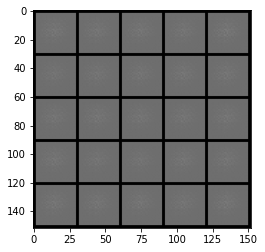

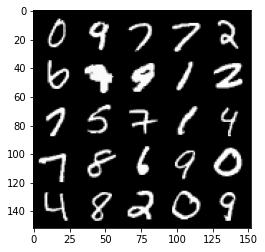

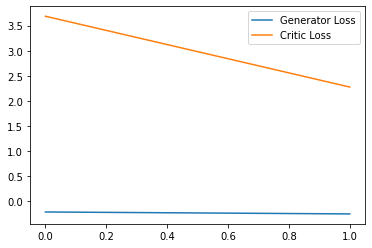

Step 100: Generator loss: 0.9676477916538715, critic loss: -1.404784598827362


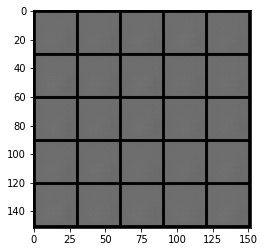

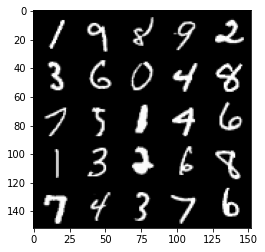

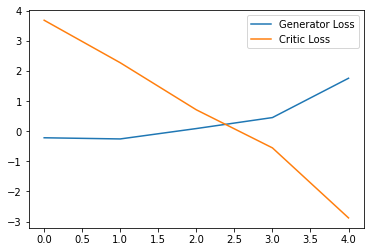

Step 150: Generator loss: 3.205589771270752, critic loss: -8.528134054183958


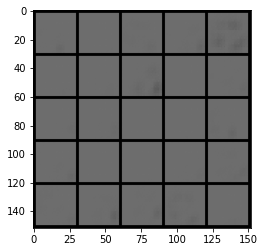

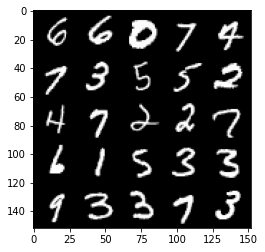

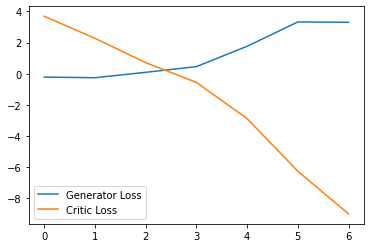

Step 200: Generator loss: 2.525686118602753, critic loss: -21.978837429046624


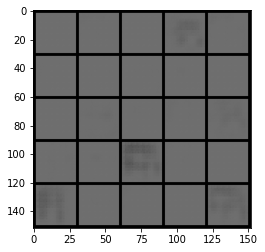

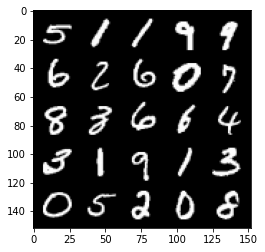

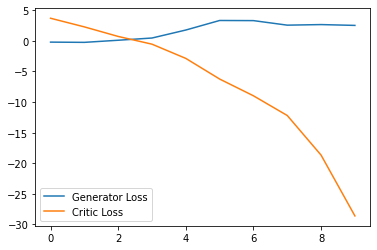

Step 250: Generator loss: 3.4024747228622436, critic loss: -51.29667524719239


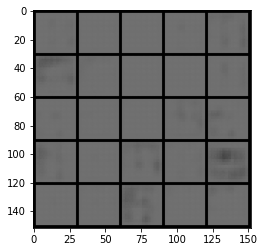

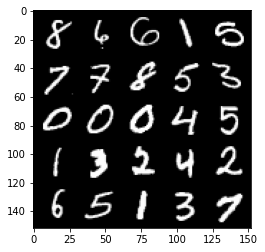

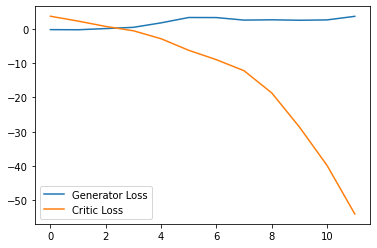

Step 300: Generator loss: 6.422866868972778, critic loss: -88.5909620666504


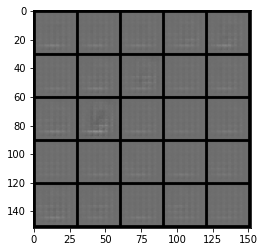

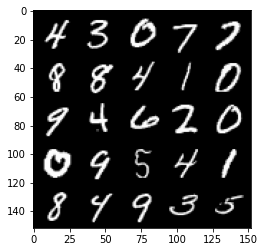

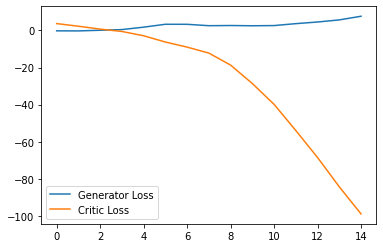

Step 350: Generator loss: 8.46802417755127, critic loss: -132.10409252929688


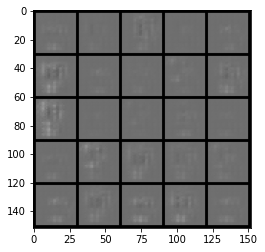

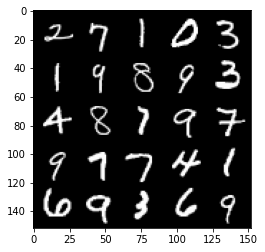

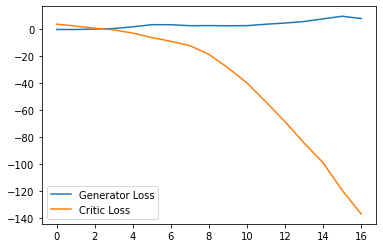

Step 400: Generator loss: 11.505891566276551, critic loss: -178.6096182250977


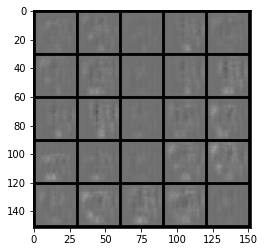

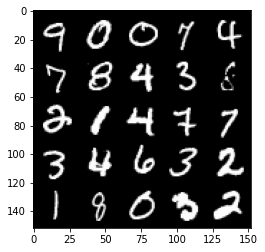

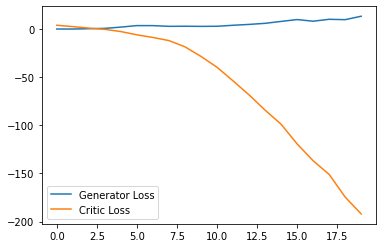

Step 450: Generator loss: 13.306695671081544, critic loss: -230.44801312255862


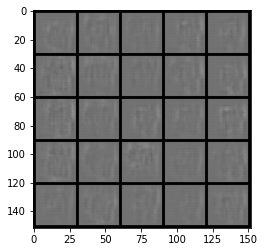

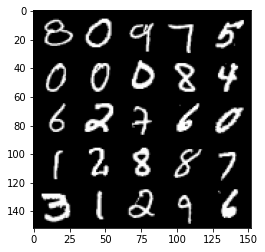

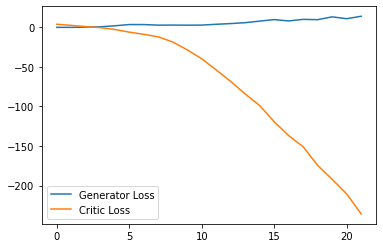

  0%|          | 0/469 [00:00<?, ?it/s]

Step 500: Generator loss: 14.93015172958374, critic loss: -267.5782026367187


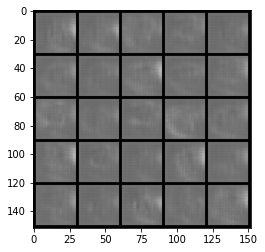

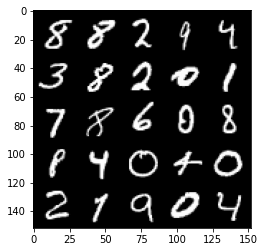

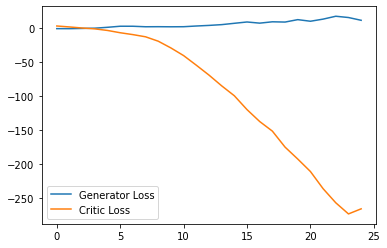

Step 550: Generator loss: 4.231067771911621, critic loss: -276.78304986572266


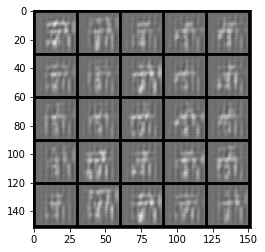

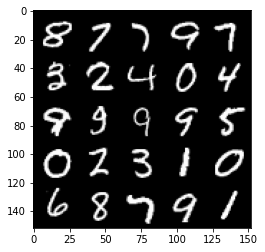

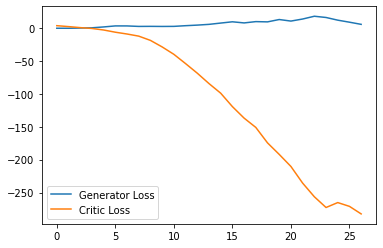

Step 600: Generator loss: 15.509056820869446, critic loss: -323.4753094482422


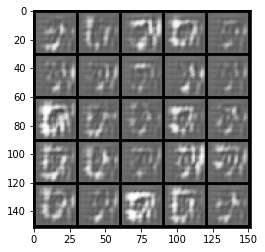

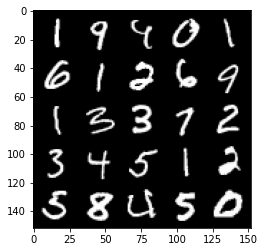

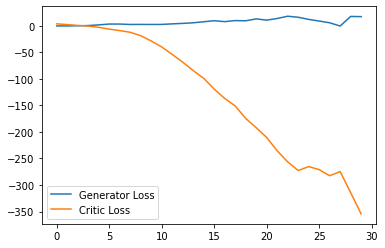

Step 650: Generator loss: -6.098280589580536, critic loss: -330.8100487670899


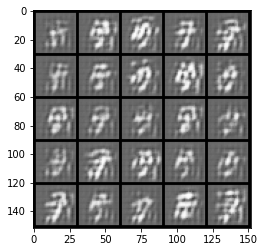

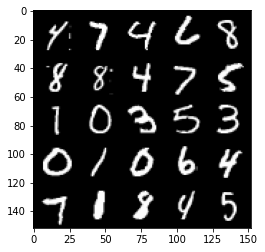

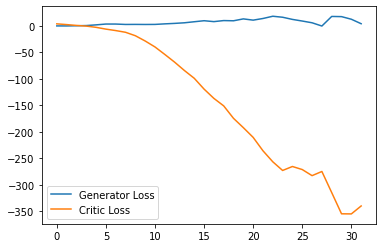

Step 700: Generator loss: -51.68260841608048, critic loss: -238.87142823791496


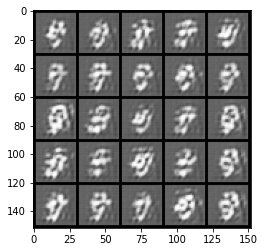

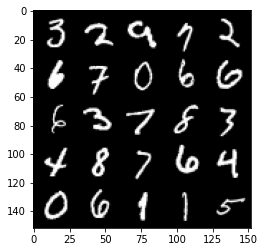

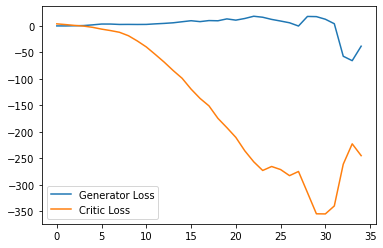

Step 750: Generator loss: 6.914867022037506, critic loss: -306.0181837921142


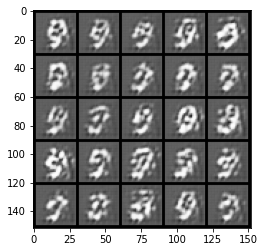

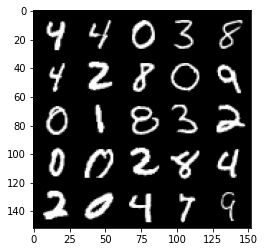

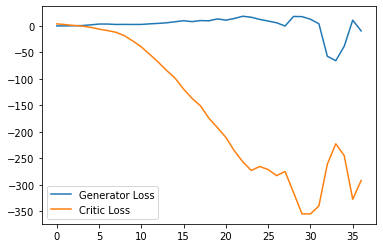

Step 800: Generator loss: -18.0522895526886, critic loss: -235.5111119384766


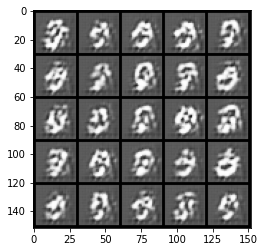

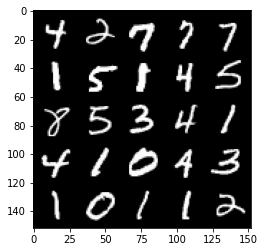

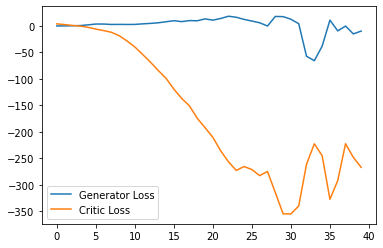

Step 850: Generator loss: -17.964611060619355, critic loss: -178.84863330078122


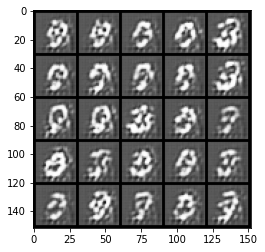

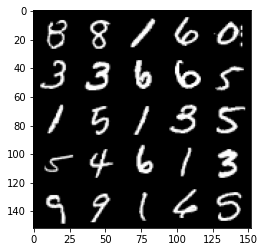

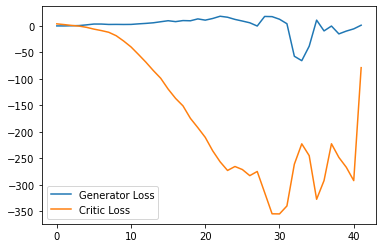

Step 900: Generator loss: -45.74668606877327, critic loss: -198.09734193420408


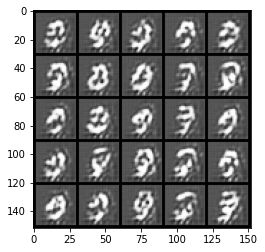

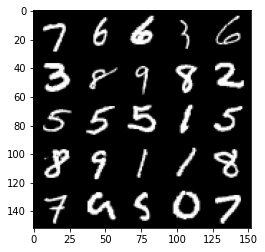

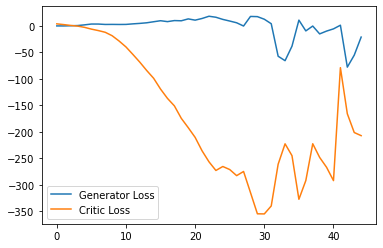

  0%|          | 0/469 [00:00<?, ?it/s]

Step 950: Generator loss: -13.086761553287506, critic loss: -200.76150546264657


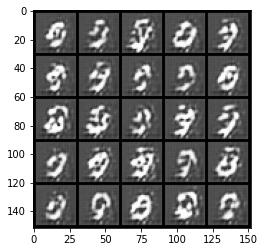

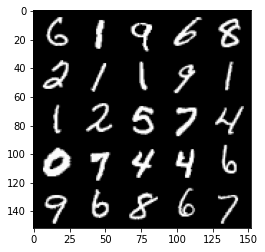

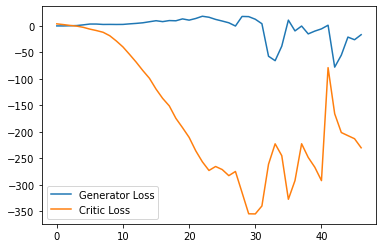

Step 1000: Generator loss: -51.40373653411865, critic loss: -180.36075259399414


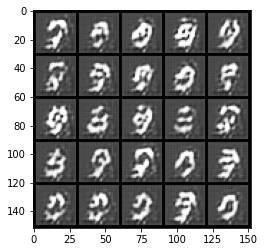

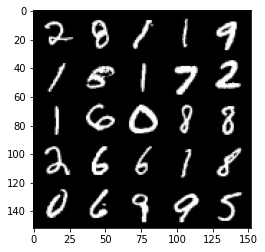

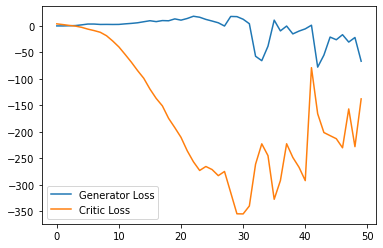

Step 1050: Generator loss: -12.06701750278473, critic loss: -219.3886597900391


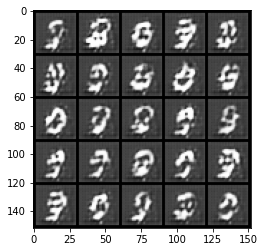

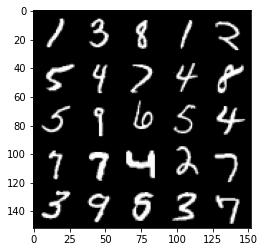

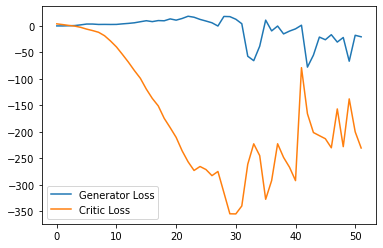

Step 1100: Generator loss: -29.39309957265854, critic loss: -190.06346899414066


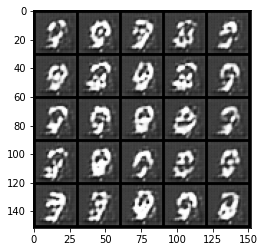

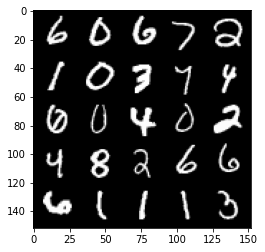

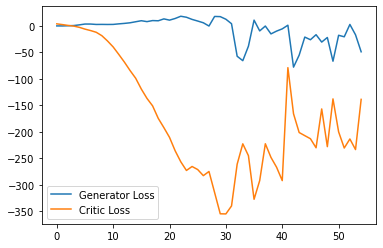

Step 1150: Generator loss: -23.60848343849182, critic loss: -110.03000101470947


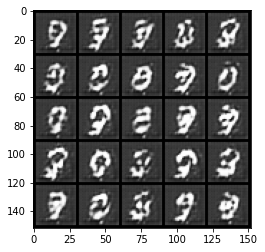

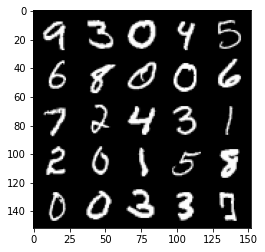

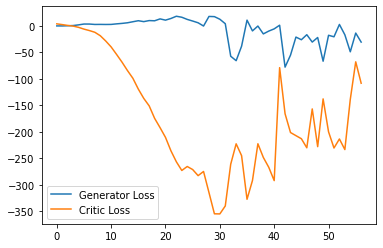

Step 1200: Generator loss: -4.015707668066025, critic loss: -69.73074491882325


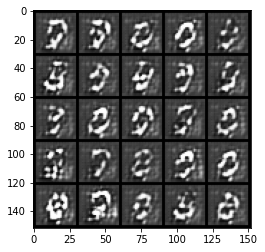

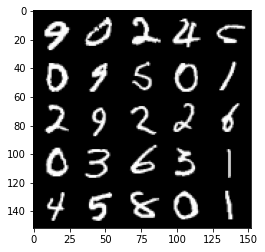

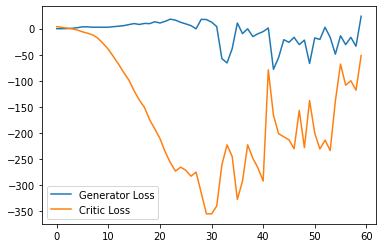

Step 1250: Generator loss: -55.239615329802035, critic loss: -157.40648913574216


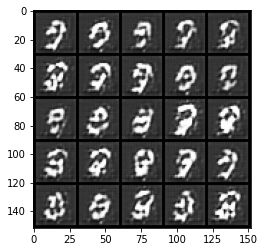

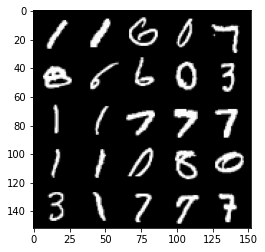

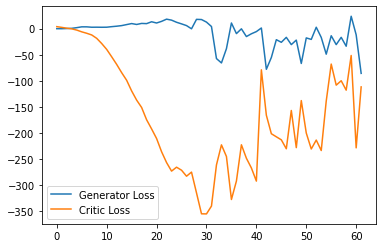

Step 1300: Generator loss: -68.07478813171387, critic loss: -138.75854083251954


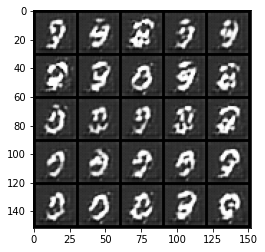

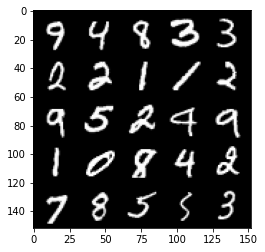

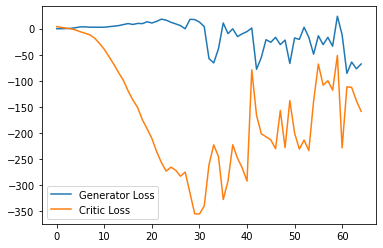

Step 1350: Generator loss: -16.788020795285703, critic loss: 7.2947345771789776


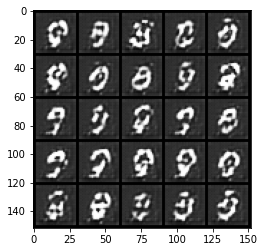

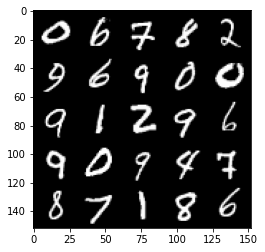

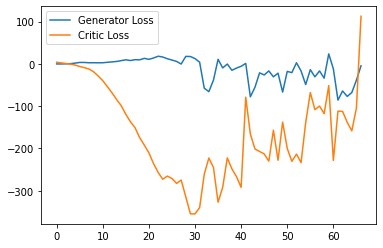

Step 1400: Generator loss: 0.061480063647031784, critic loss: 6.584922244071963


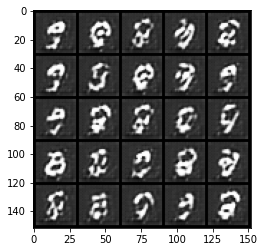

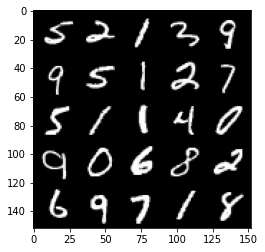

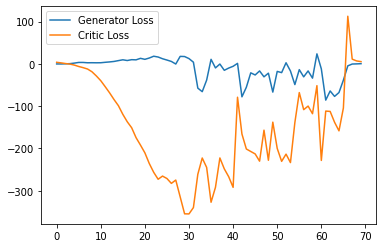

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1450: Generator loss: 2.1590776312351228, critic loss: 3.274397018432617


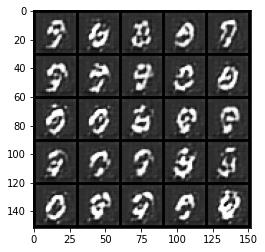

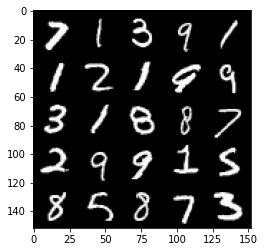

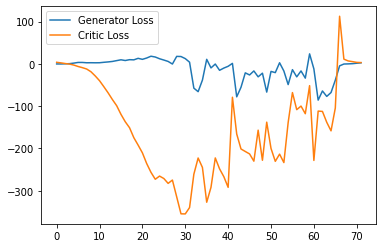

Step 1500: Generator loss: 3.747479701042175, critic loss: 5.030261215209962


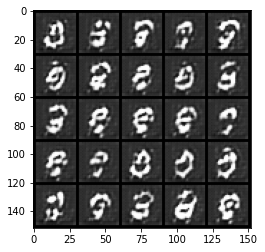

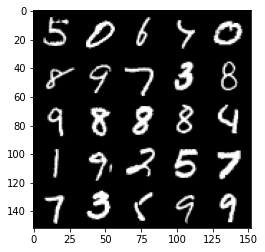

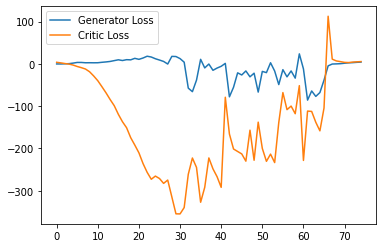

Step 1550: Generator loss: 4.362229480743408, critic loss: 7.379031915664672


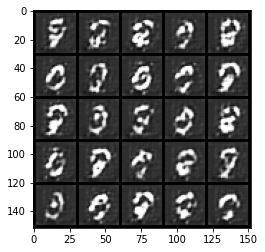

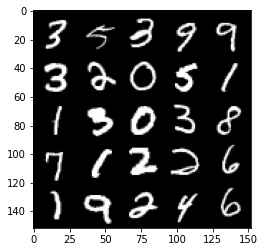

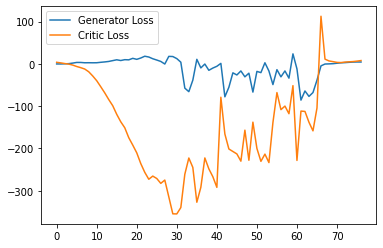

Step 1600: Generator loss: 1.444978034198284, critic loss: 8.868993441581729


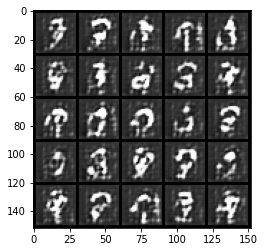

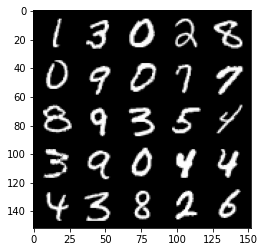

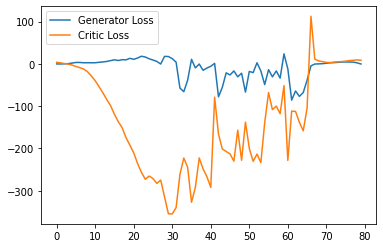

Step 1650: Generator loss: -2.8996014404296875, critic loss: 9.357803349494931


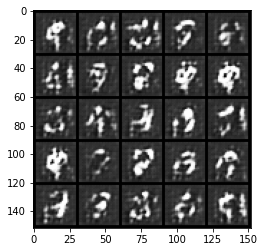

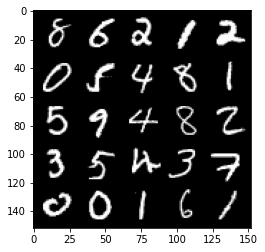

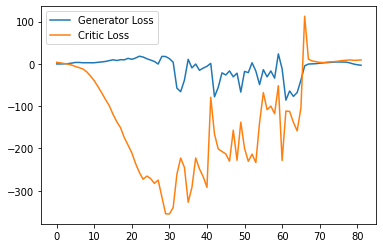

Step 1700: Generator loss: -3.7680025053024293, critic loss: 16.208698980331427


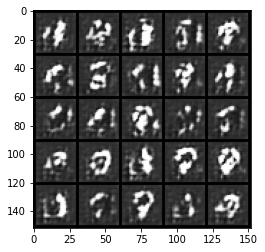

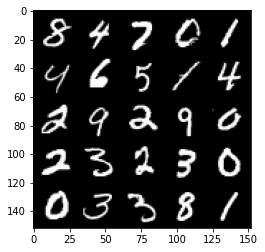

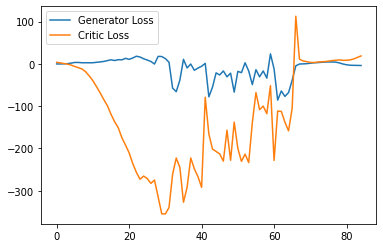

Step 1750: Generator loss: -4.507752561569214, critic loss: 20.87662368392944


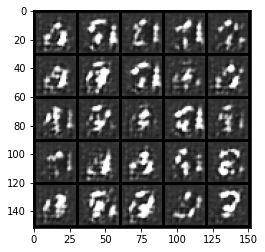

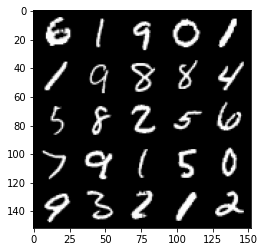

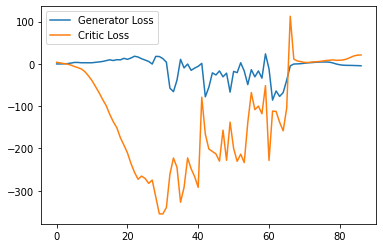

Step 1800: Generator loss: -5.893992586135864, critic loss: 17.505320987701417


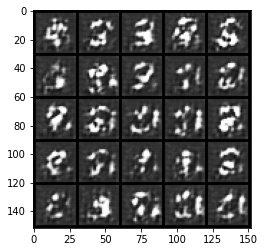

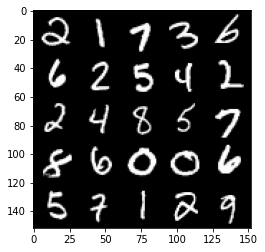

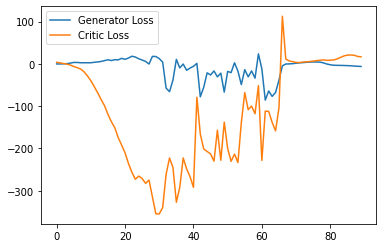

Step 1850: Generator loss: -6.910059022903442, critic loss: 14.500274803161622


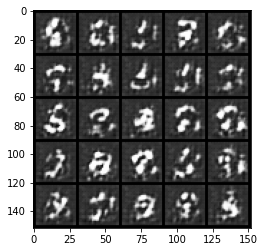

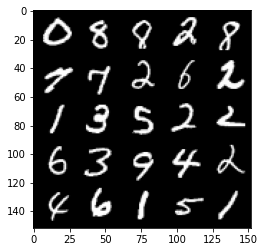

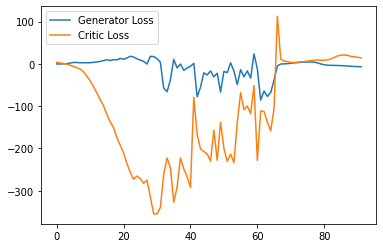

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1900: Generator loss: -7.958677396774292, critic loss: 11.05138416862488


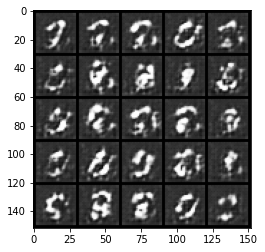

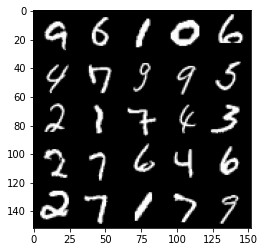

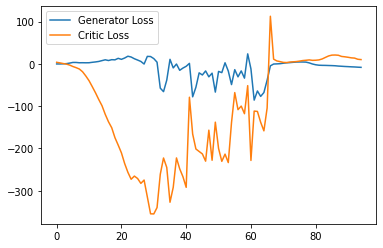

Step 1950: Generator loss: -10.004997978210449, critic loss: 6.816041702270505


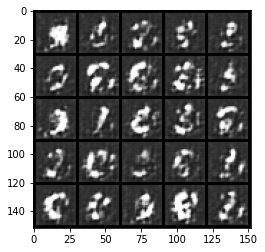

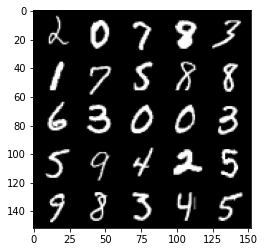

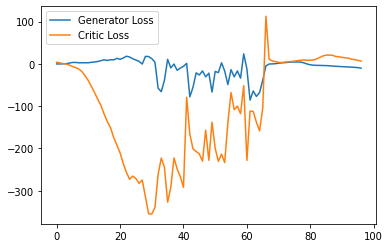

Step 2000: Generator loss: -12.318652076721191, critic loss: 3.9722353725433353


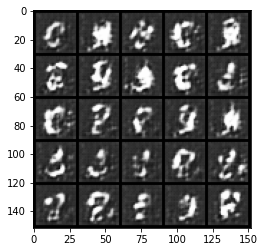

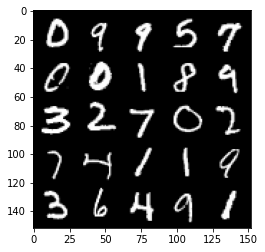

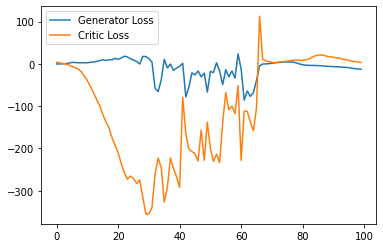

Step 2050: Generator loss: -12.992167854309082, critic loss: 1.1255835151672364


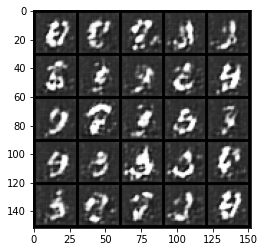

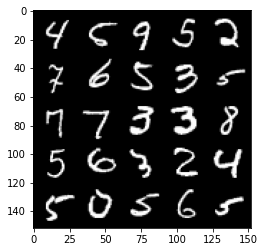

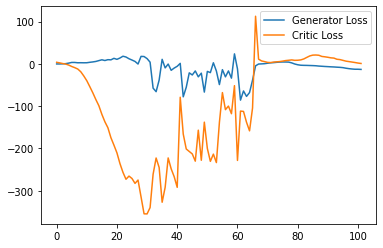

Step 2100: Generator loss: -13.710414295196534, critic loss: -0.3927123451232912


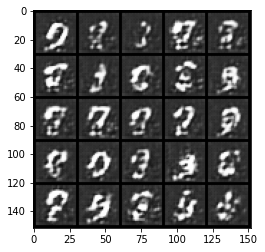

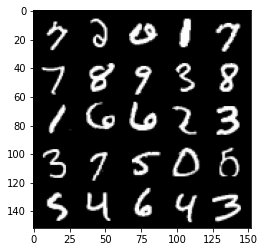

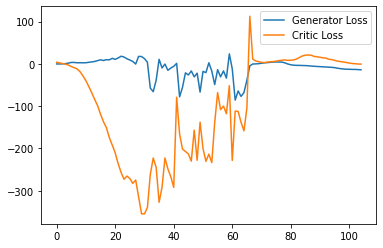

Step 2150: Generator loss: -14.593168678283691, critic loss: -1.7855733041763302


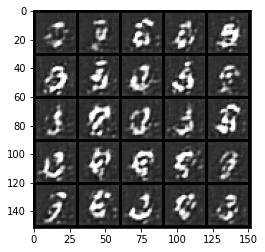

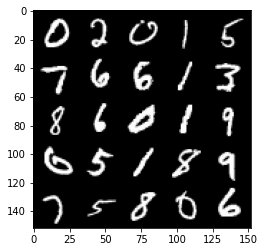

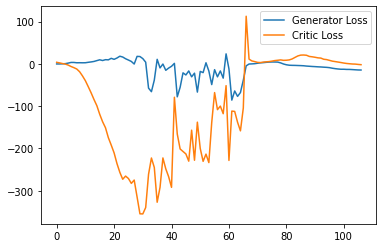

Step 2200: Generator loss: -14.862893867492676, critic loss: -3.003674899101257


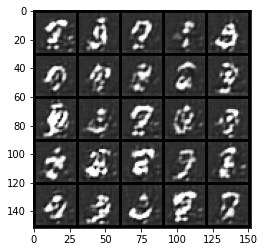

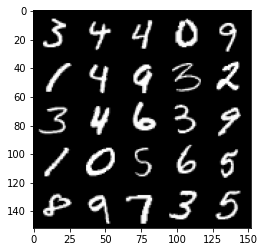

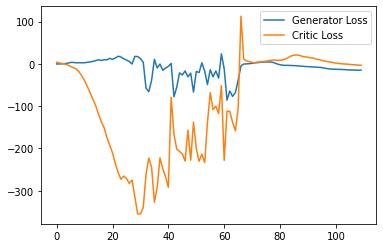

Step 2250: Generator loss: -14.349882411956788, critic loss: -4.210787821769714


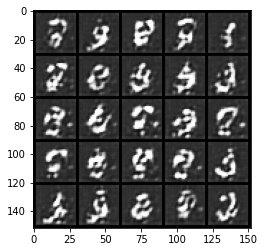

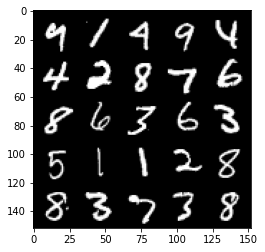

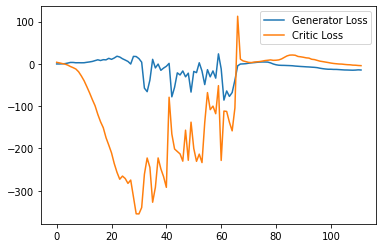

Step 2300: Generator loss: -14.570637607574463, critic loss: -5.398739348411559


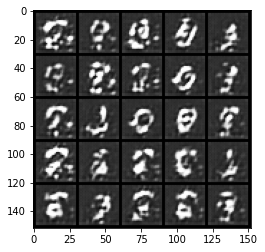

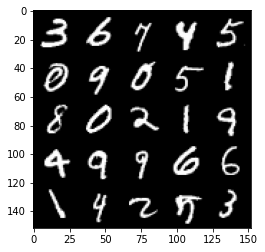

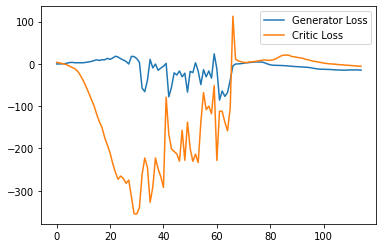

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2350: Generator loss: -15.170368175506592, critic loss: -7.232797508239745


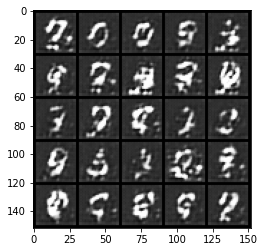

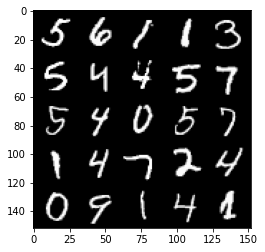

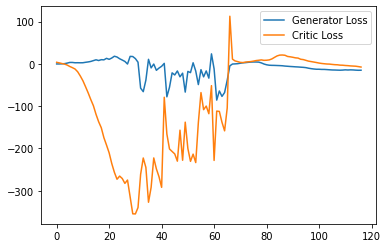

Step 2400: Generator loss: -15.444791164398193, critic loss: -9.41111050415039


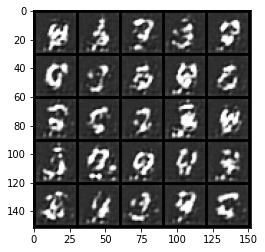

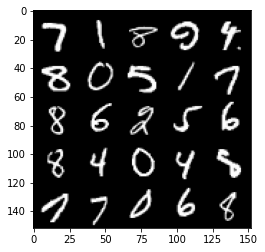

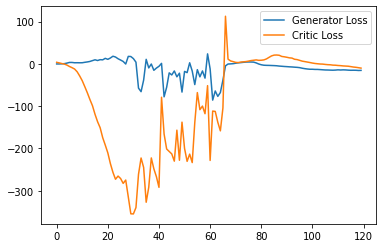

Step 2450: Generator loss: -15.792241878509522, critic loss: -10.880804285049441


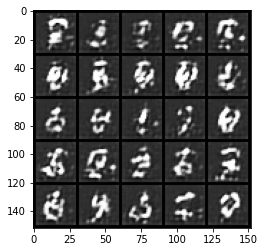

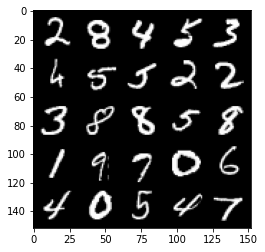

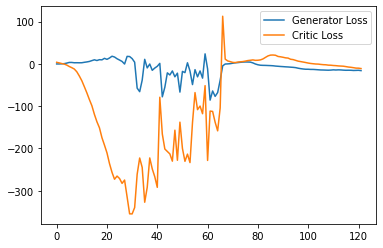

Step 2500: Generator loss: -15.933640098571777, critic loss: -12.797415058135988


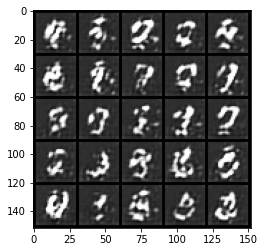

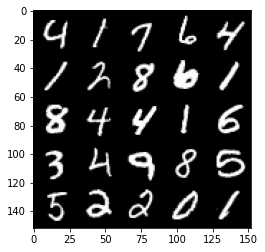

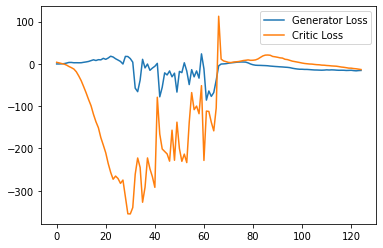

Step 2550: Generator loss: -16.249632720947265, critic loss: -15.029613628387454


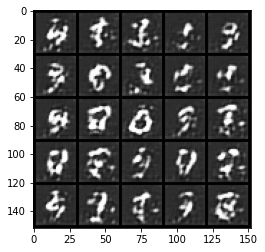

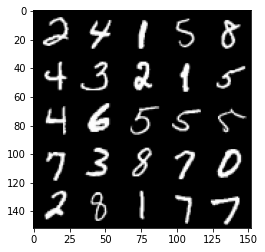

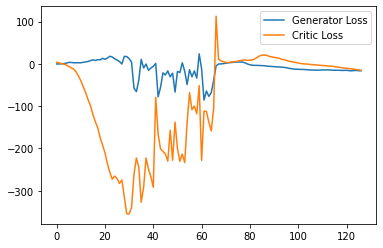

Step 2600: Generator loss: -16.233506946563722, critic loss: -16.723039762496953


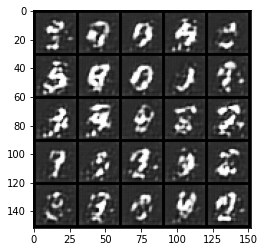

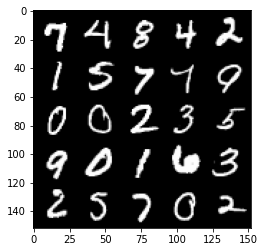

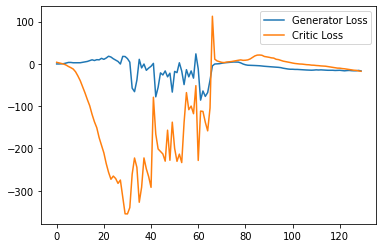

Step 2650: Generator loss: -16.746686382293703, critic loss: -20.128218383789054


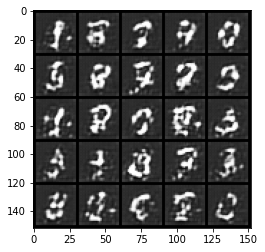

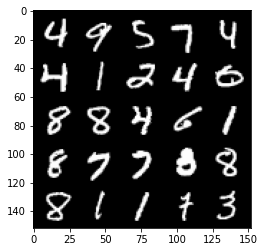

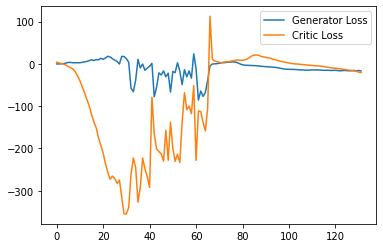

Step 2700: Generator loss: -17.94155252456665, critic loss: -24.976304971694944


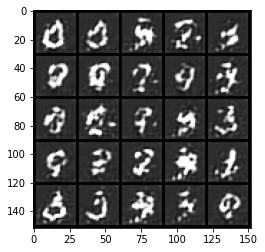

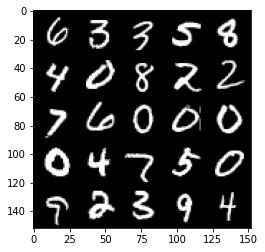

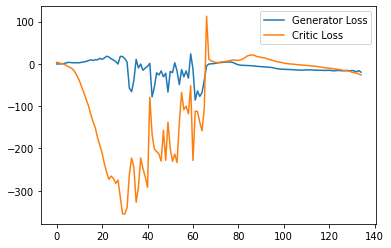

Step 2750: Generator loss: -19.46756242752075, critic loss: -27.925585536956792


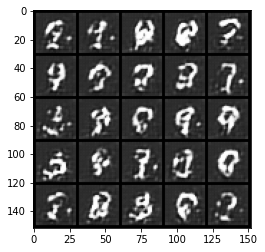

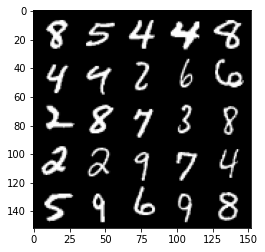

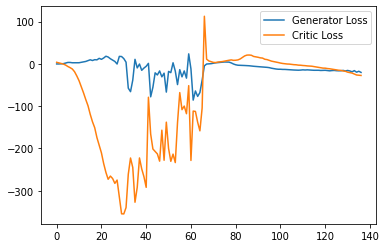

Step 2800: Generator loss: -18.26612473487854, critic loss: -29.969238239288337


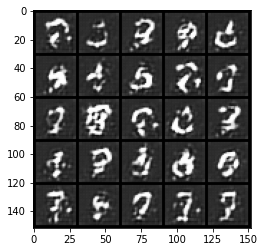

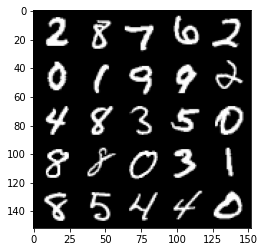

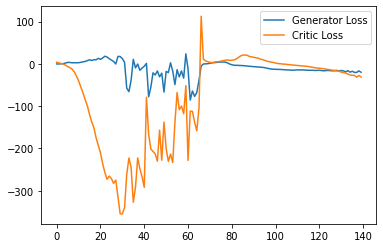

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2850: Generator loss: -21.441433792114257, critic loss: -28.34940854263306


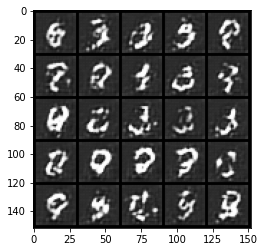

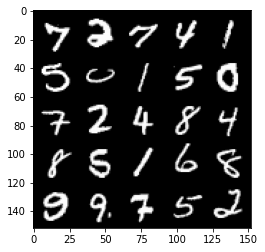

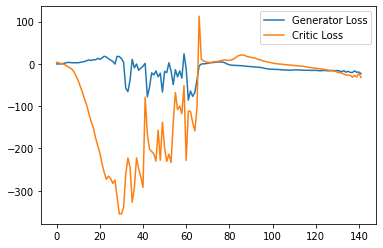

Step 2900: Generator loss: -22.50499767303467, critic loss: -33.88370536422729


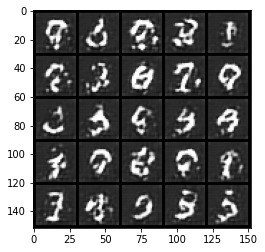

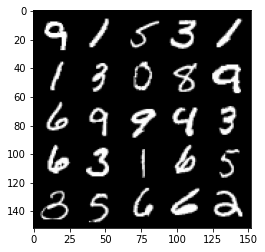

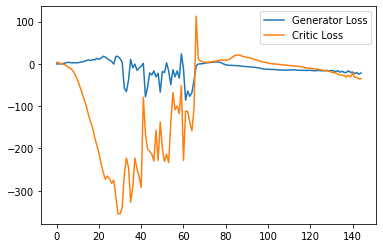

Step 2950: Generator loss: -22.49340624809265, critic loss: -26.726797592163095


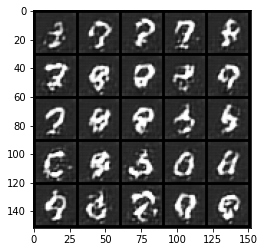

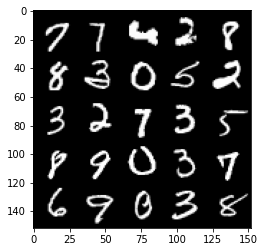

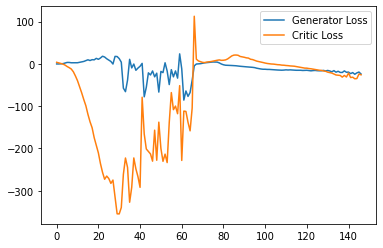

Step 3000: Generator loss: -22.61366349697113, critic loss: -34.01914080047607


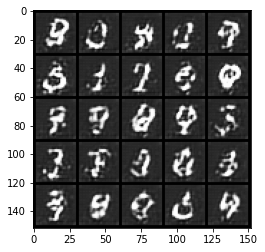

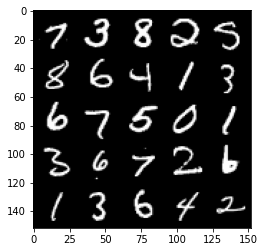

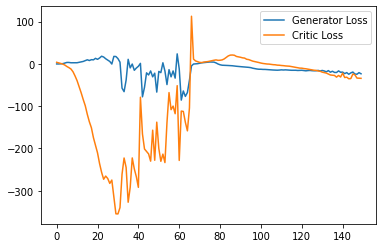

Step 3050: Generator loss: -24.182803478240967, critic loss: -27.959236883163452


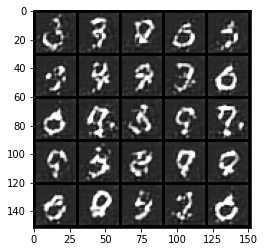

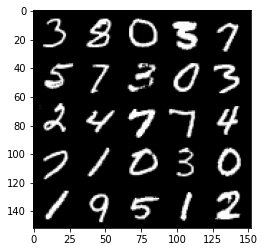

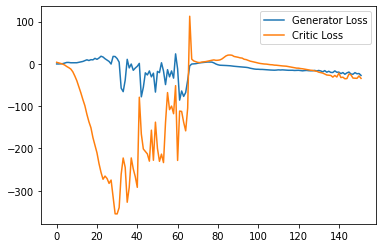

Step 3100: Generator loss: -26.588892879486085, critic loss: -35.52386547088623


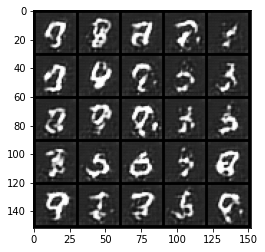

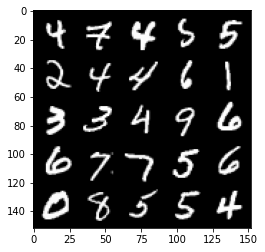

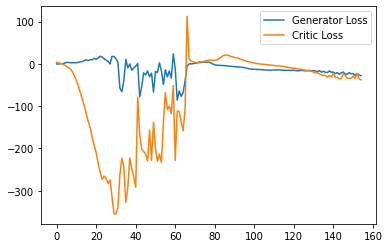

Step 3150: Generator loss: -19.622274837493897, critic loss: -12.570943069458004


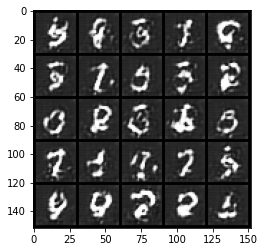

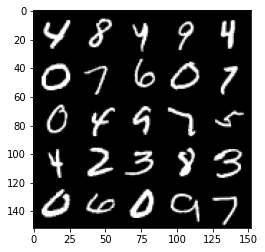

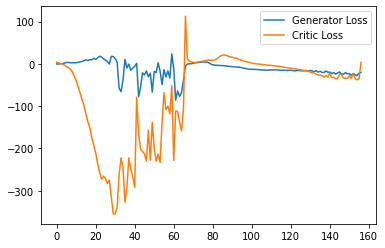

Step 3200: Generator loss: -26.346989784240723, critic loss: -26.129774263381965


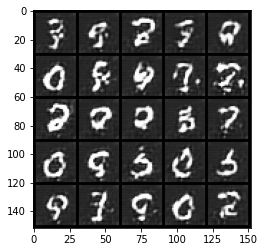

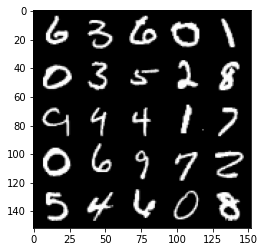

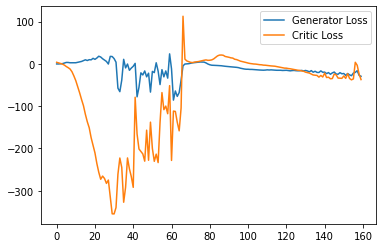

Step 3250: Generator loss: -28.768224029541017, critic loss: -36.18745105743408


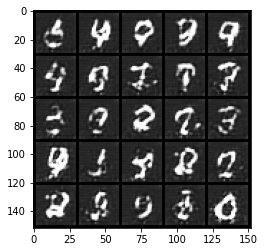

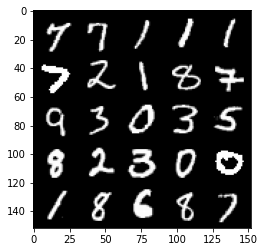

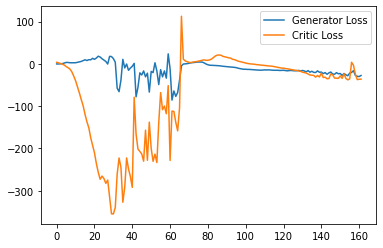

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3300: Generator loss: -28.4008296585083, critic loss: -37.316890027999875


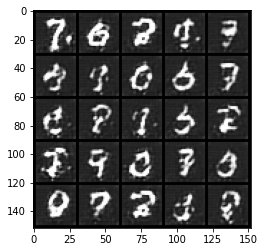

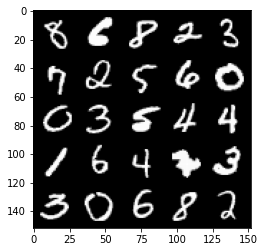

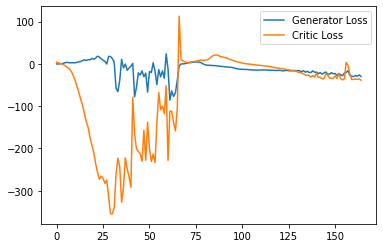

Step 3350: Generator loss: -28.279622846543788, critic loss: -38.07137110710144


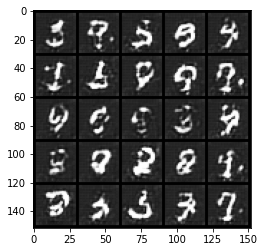

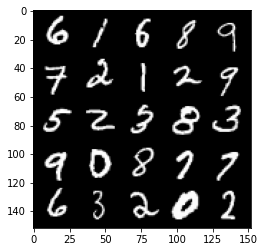

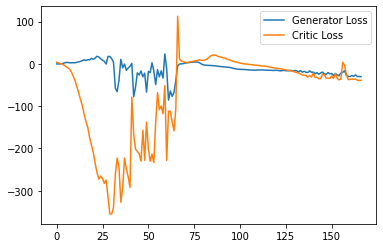

Step 3400: Generator loss: -25.2238570022583, critic loss: -31.07136896133423


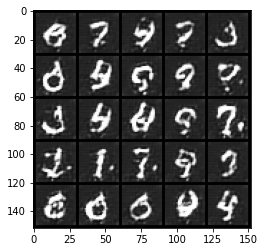

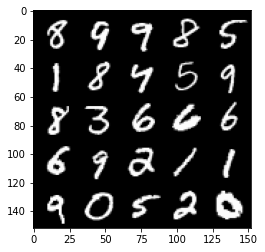

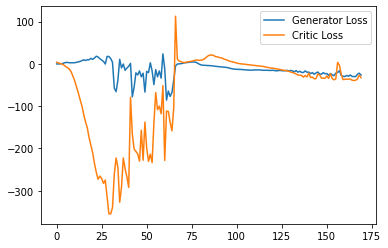

Step 3450: Generator loss: -28.055318138599397, critic loss: -36.90788519859315


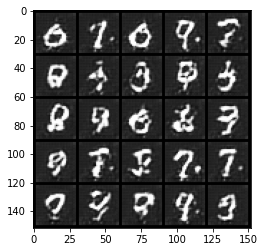

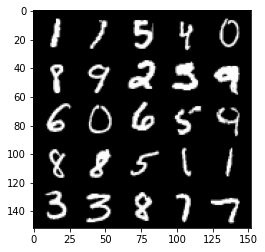

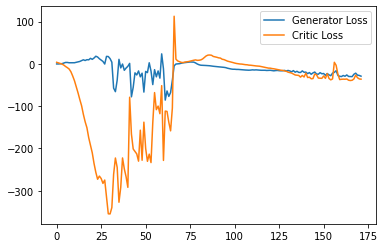

Step 3500: Generator loss: -30.01572968006134, critic loss: -36.53989460945129


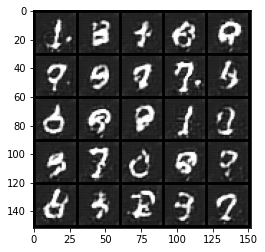

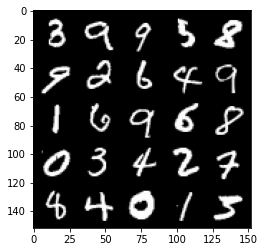

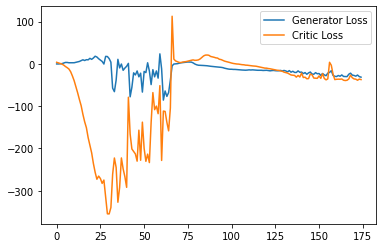

Step 3550: Generator loss: -25.72624478816986, critic loss: -38.153654615402225


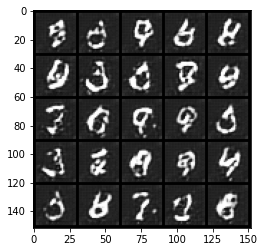

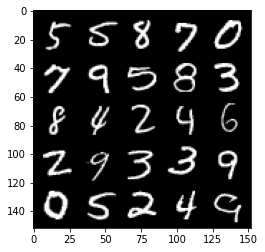

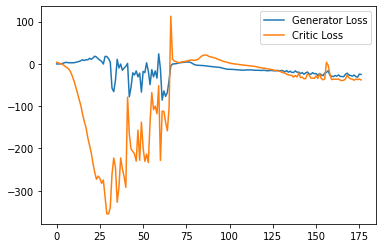

Step 3600: Generator loss: -25.911450510025023, critic loss: -31.194057240486146


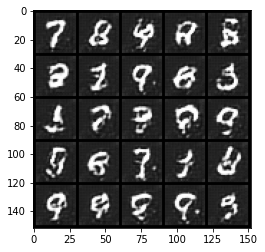

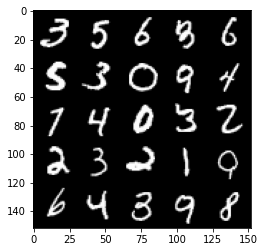

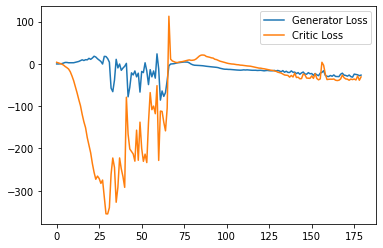

Step 3650: Generator loss: -23.520764331817627, critic loss: -27.06769091415406


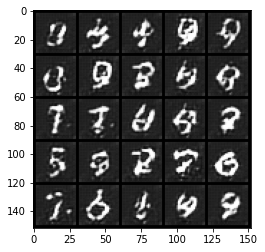

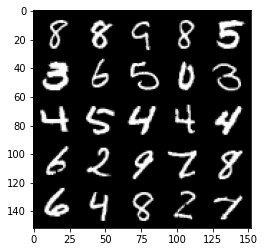

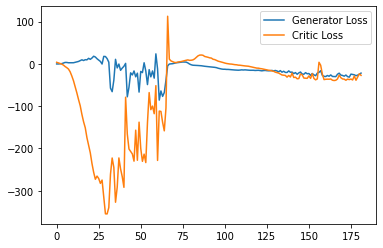

Step 3700: Generator loss: -25.08512106657028, critic loss: -36.60688272666932


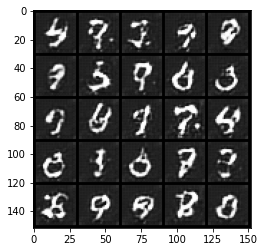

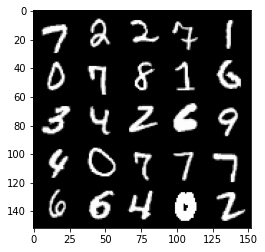

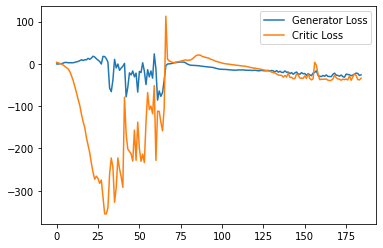

Step 3750: Generator loss: -24.195280129909516, critic loss: -30.57162181282044


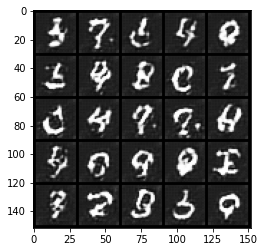

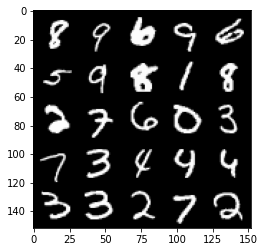

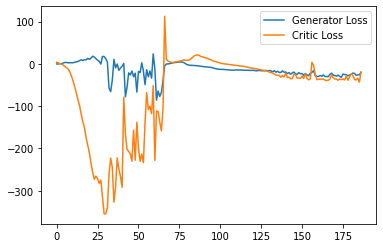

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3800: Generator loss: -22.71496382832527, critic loss: -31.381922557830812


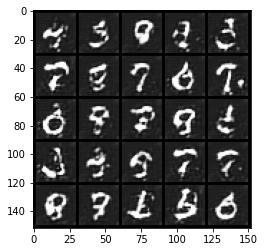

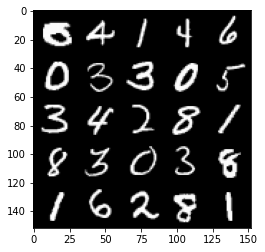

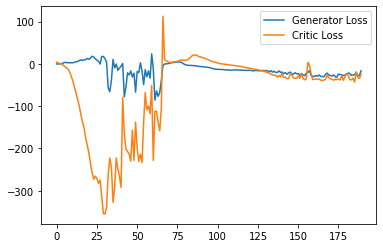

Step 3850: Generator loss: -27.164498121738433, critic loss: -34.128947038650516


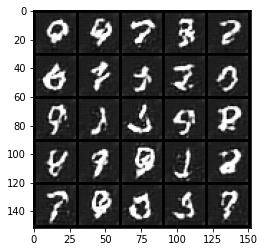

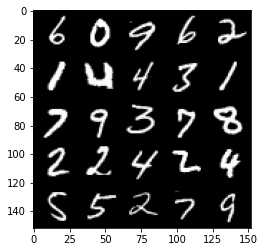

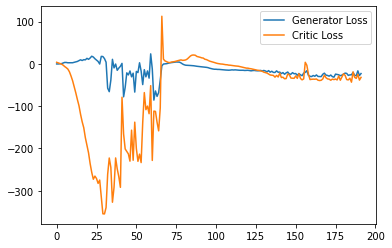

Step 3900: Generator loss: -21.48549282312393, critic loss: -29.59555693054199


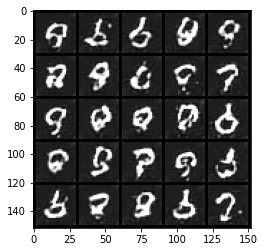

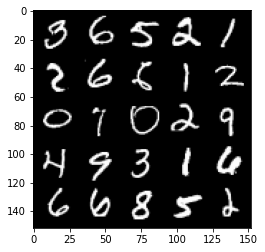

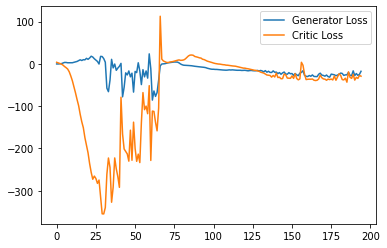

Step 3950: Generator loss: -15.455418663024902, critic loss: -8.81913509273529


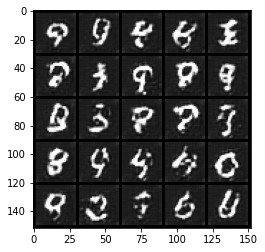

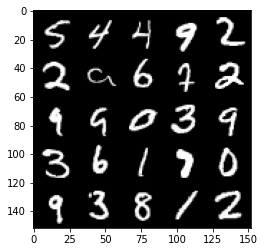

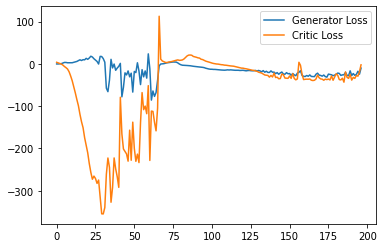

Step 4000: Generator loss: -27.065541048049926, critic loss: -30.437726705551153


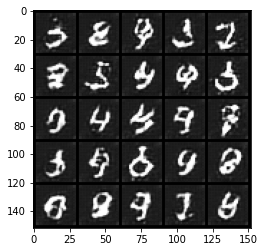

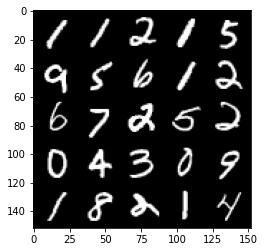

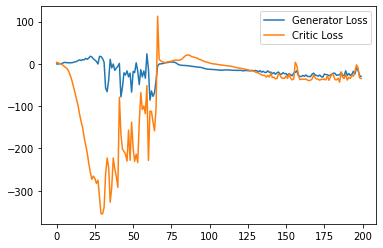

Step 4050: Generator loss: -20.582169711589813, critic loss: -14.177254985809336


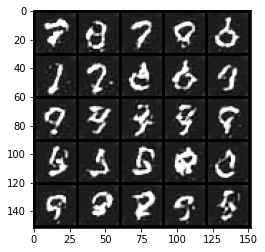

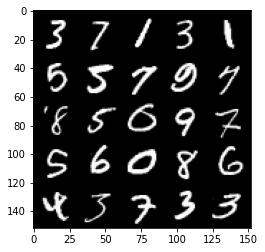

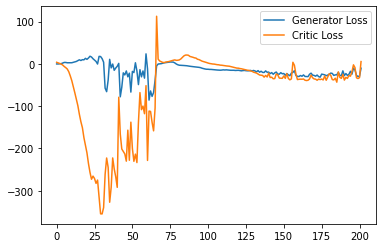

Step 4100: Generator loss: -27.007134170532225, critic loss: -32.022211441040035


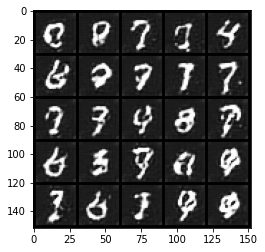

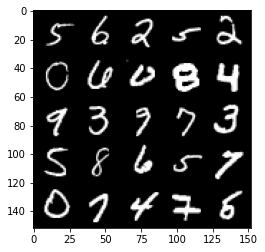

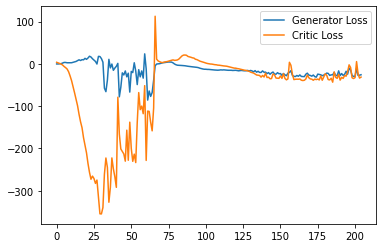

Step 4150: Generator loss: -23.35388931751251, critic loss: -28.417126781463626


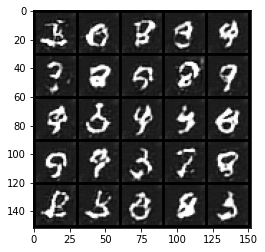

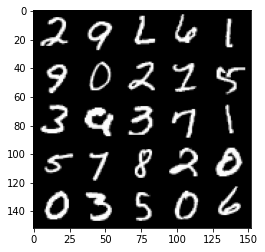

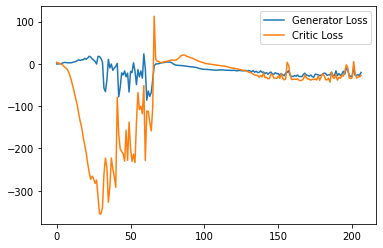

Step 4200: Generator loss: -19.207300725206732, critic loss: -28.76136037635803


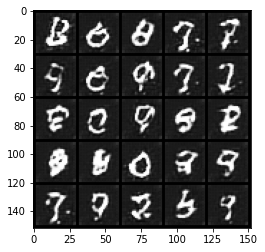

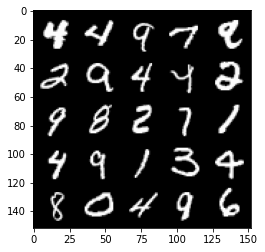

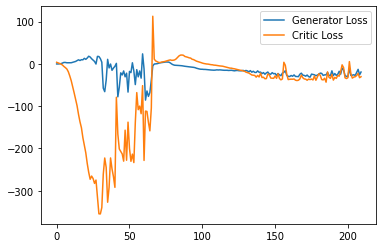

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4250: Generator loss: -19.46776515007019, critic loss: -28.995784683227534


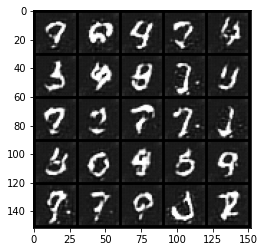

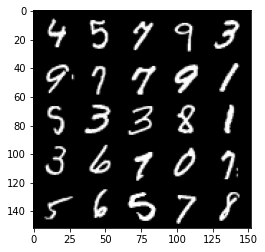

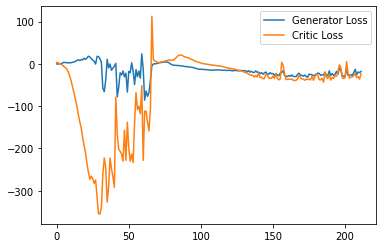

Step 4300: Generator loss: -24.453849878311157, critic loss: -25.400648389816286


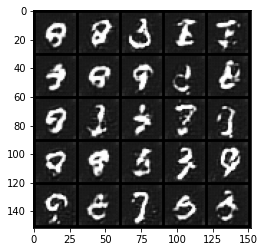

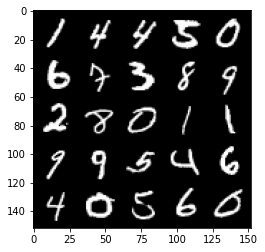

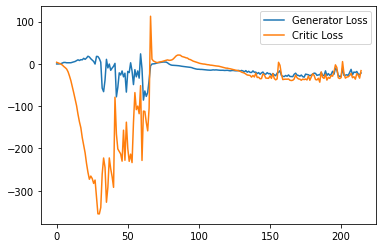

Step 4350: Generator loss: -11.50695258140564, critic loss: -9.545101699829102


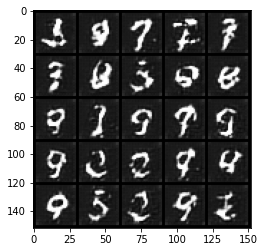

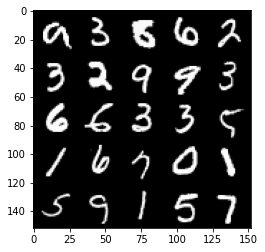

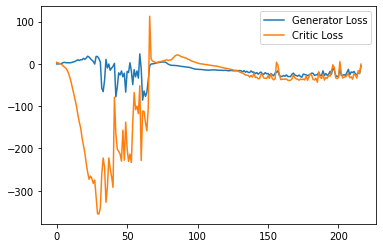

Step 4400: Generator loss: -15.11273138999939, critic loss: -12.639789130210877


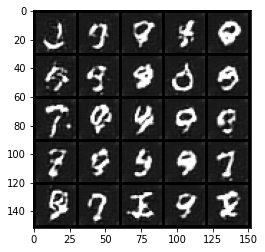

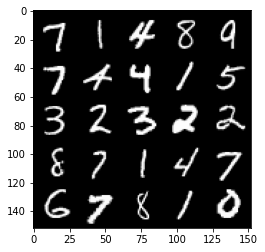

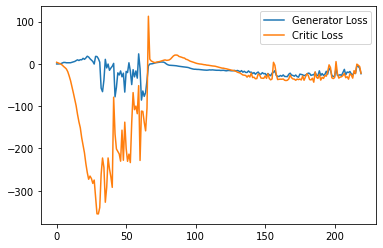

Step 4450: Generator loss: -22.857746919989587, critic loss: -26.951667211532584


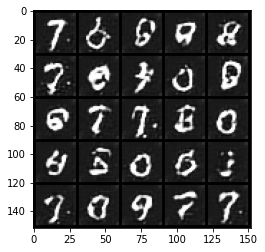

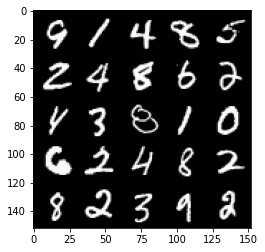

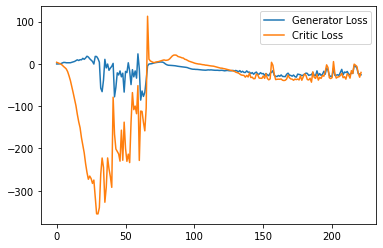

Step 4500: Generator loss: -17.367127346992493, critic loss: -8.495611711502077


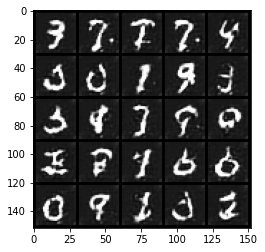

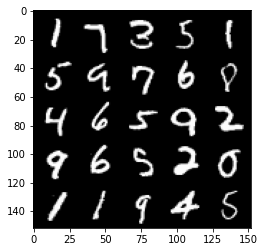

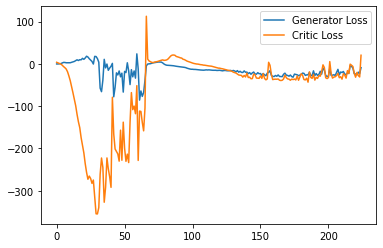

Step 4550: Generator loss: -8.399315576553345, critic loss: -1.1521433742046356


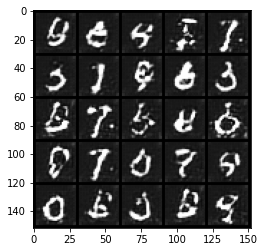

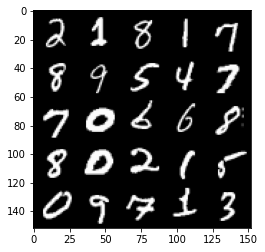

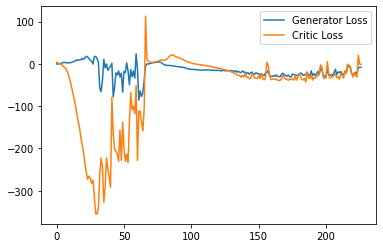

Step 4600: Generator loss: -9.66794075012207, critic loss: -1.1876864261627198


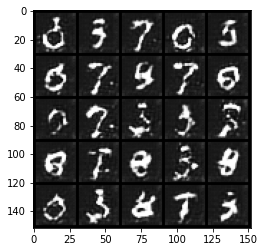

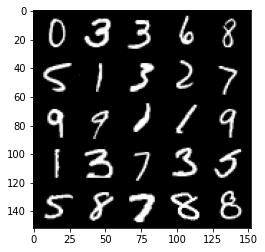

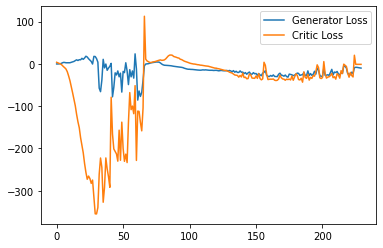

Step 4650: Generator loss: -11.13368637084961, critic loss: -1.176379961967468


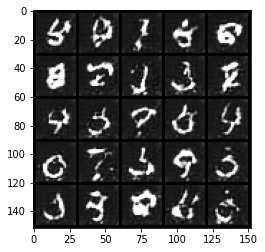

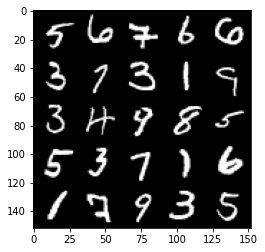

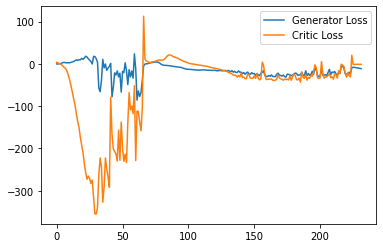

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4700: Generator loss: -13.65445520401001, critic loss: -1.0084896540641786


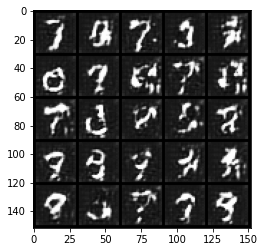

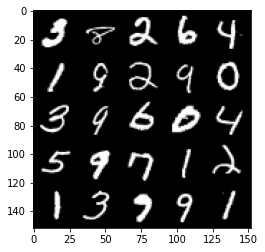

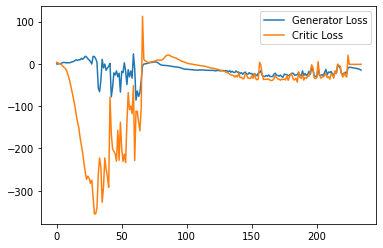

Step 4750: Generator loss: -14.79465446472168, critic loss: -1.119259677410126


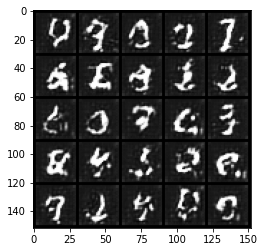

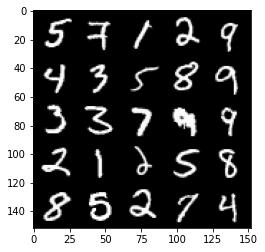

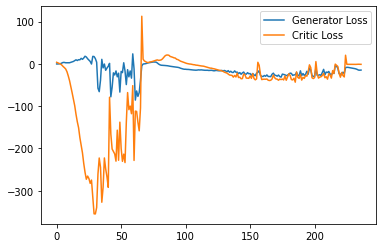

Step 4800: Generator loss: -14.428444747924805, critic loss: -1.4729453182220456


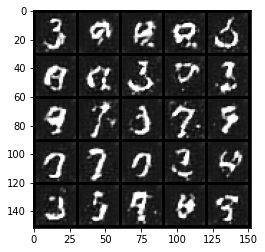

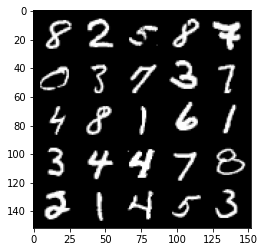

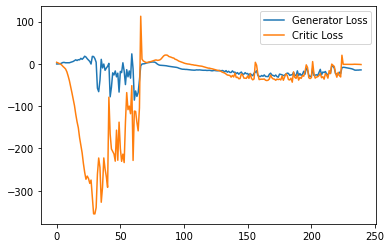

Step 4850: Generator loss: -13.192289085388184, critic loss: -2.2223181800842284


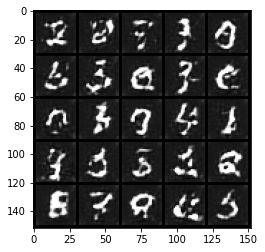

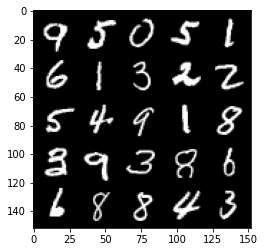

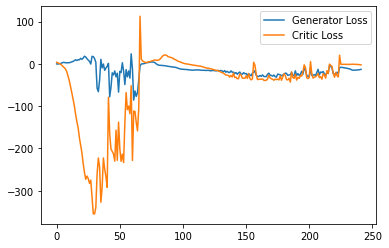

Step 4900: Generator loss: -13.0311429977417, critic loss: -4.440247437477113


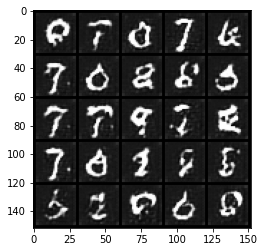

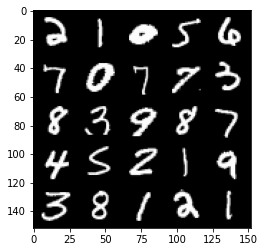

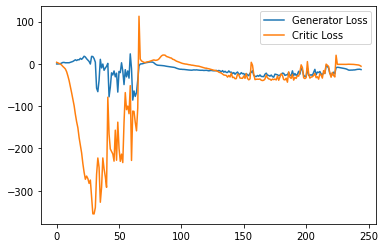

Step 4950: Generator loss: -15.934879455566406, critic loss: -9.719338373184206


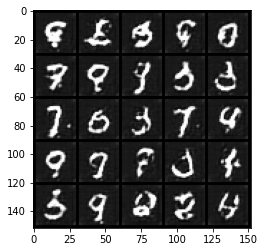

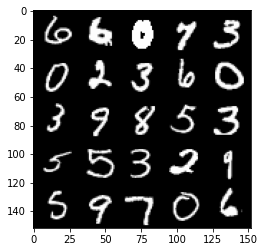

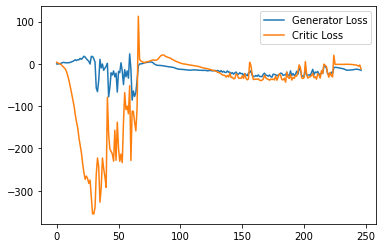

Step 5000: Generator loss: -16.254316025972365, critic loss: -19.1189978685379


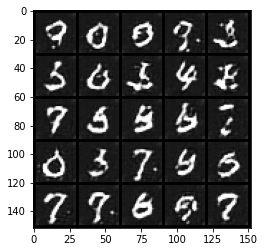

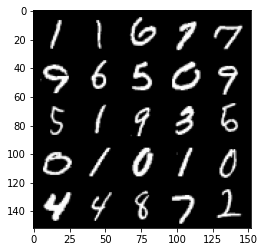

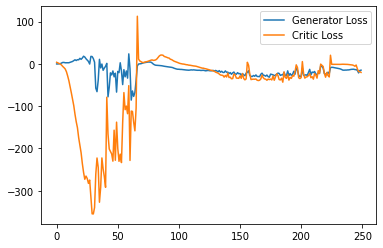

Step 5050: Generator loss: -9.093806347846986, critic loss: -4.239597029685974


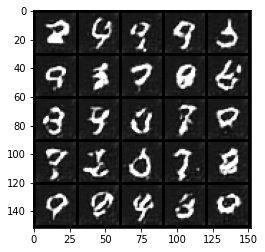

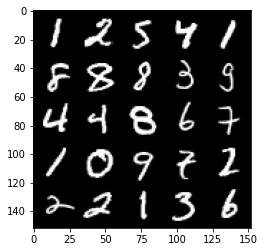

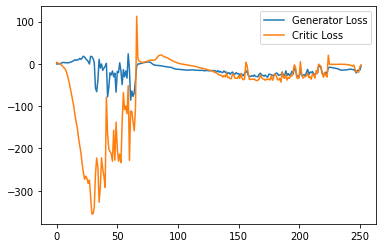

Step 5100: Generator loss: -9.590343017578125, critic loss: -8.0877370967865


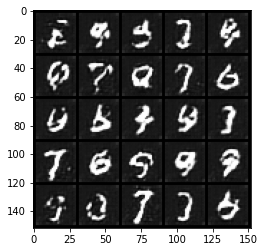

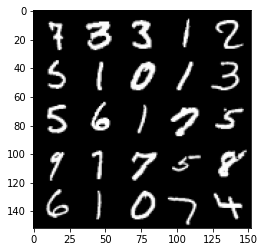

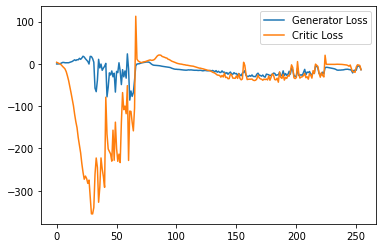

Step 5150: Generator loss: -15.512793040275573, critic loss: -8.283796861648558


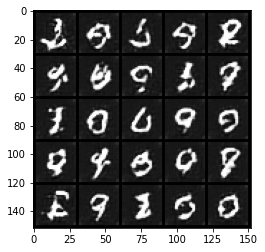

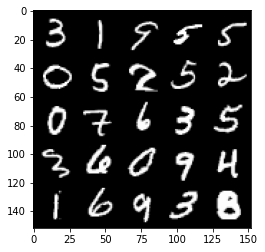

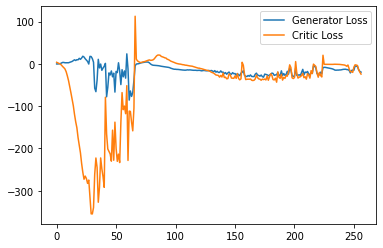

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5200: Generator loss: -3.0120124053955077, critic loss: -1.2966996600627902


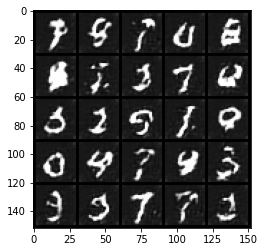

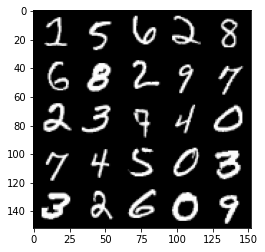

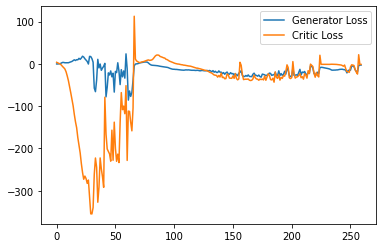

Step 5250: Generator loss: -5.084138717651367, critic loss: -1.28565442943573


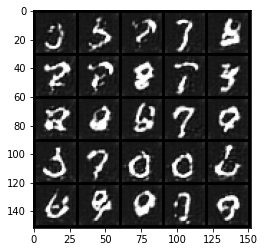

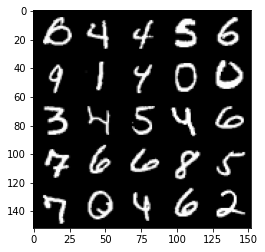

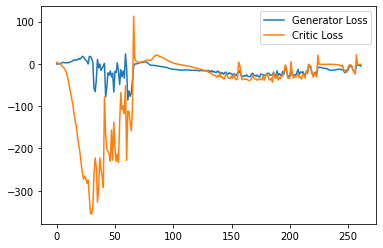

Step 5300: Generator loss: -6.670158071517944, critic loss: -1.4064646201133726


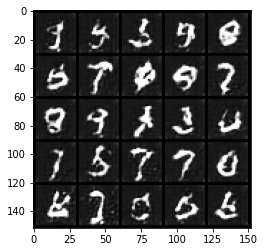

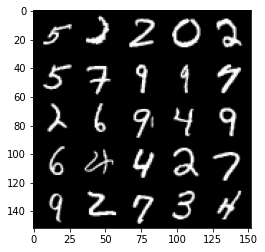

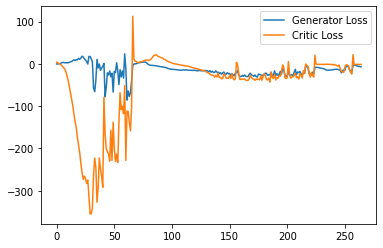

Step 5350: Generator loss: -7.058957948684692, critic loss: -1.6294100790023807


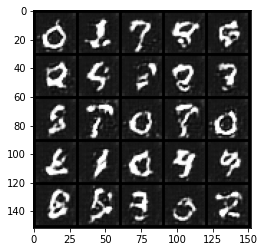

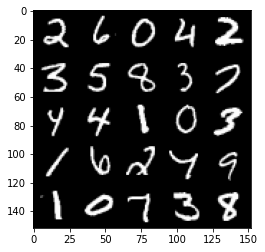

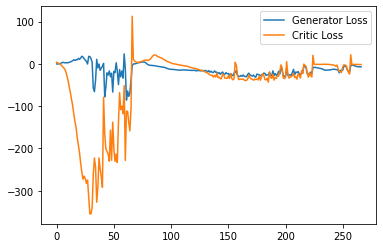

Step 5400: Generator loss: -8.13586820602417, critic loss: -1.9506692757606503


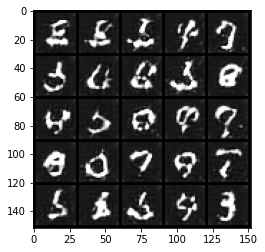

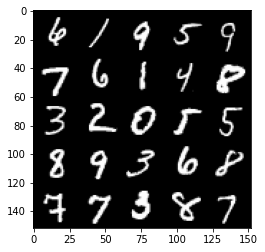

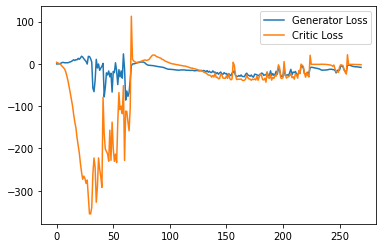

Step 5450: Generator loss: -8.535307350158691, critic loss: -2.2725517582893375


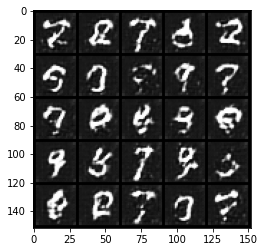

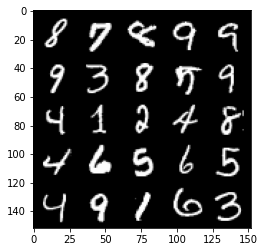

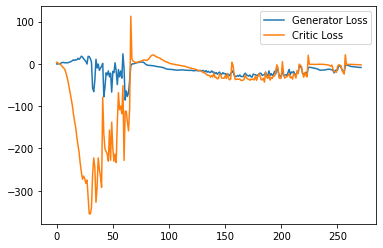

Step 5500: Generator loss: -8.211142082214355, critic loss: -2.8091866526603697


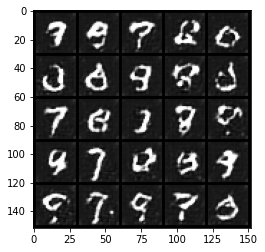

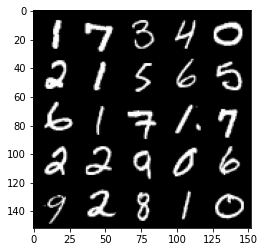

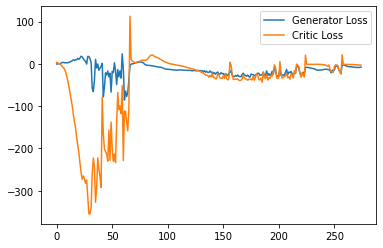

Step 5550: Generator loss: -7.854417123794556, critic loss: -4.062358364105225


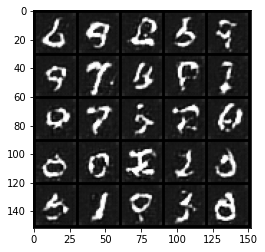

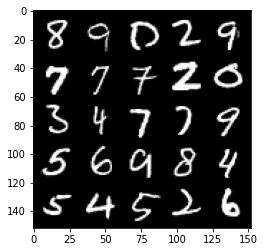

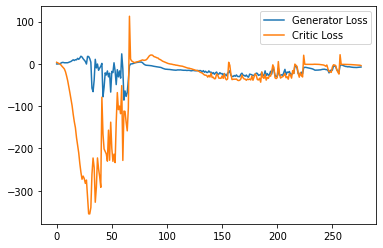

Step 5600: Generator loss: -7.079744124412537, critic loss: -1.6535295038223268


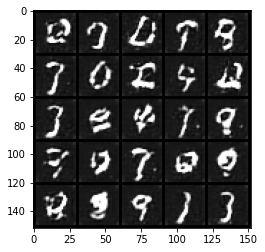

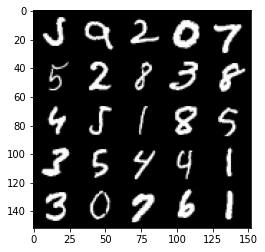

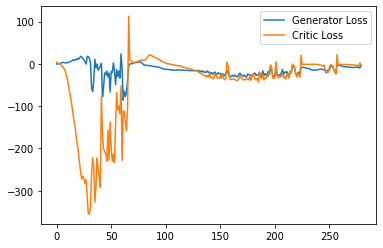

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5650: Generator loss: -10.547193121910095, critic loss: -11.139725563049314


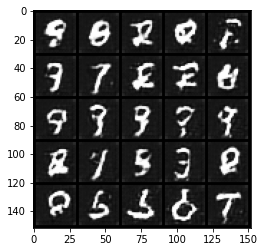

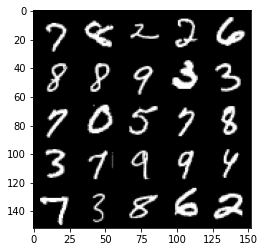

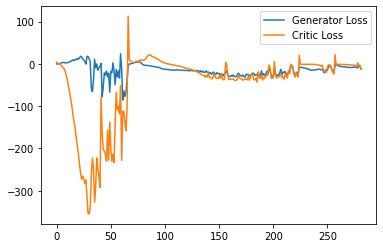

Step 5700: Generator loss: -8.956433218717574, critic loss: -12.221563721656794


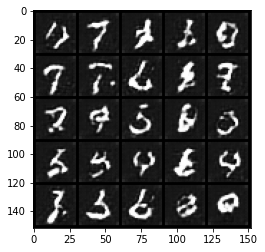

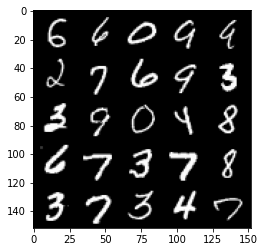

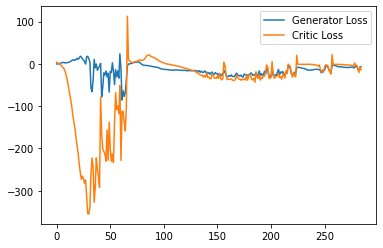

Step 5750: Generator loss: -14.99976438999176, critic loss: -18.790005346298223


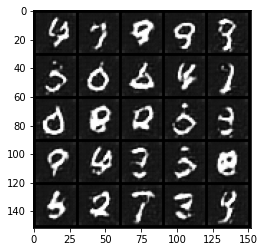

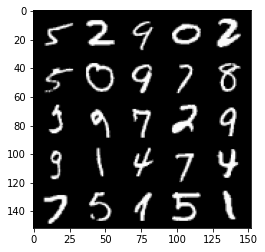

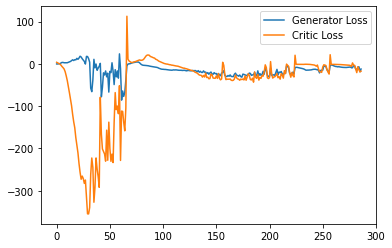

Step 5800: Generator loss: -11.89421017408371, critic loss: -22.586037981033325


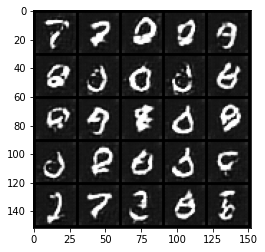

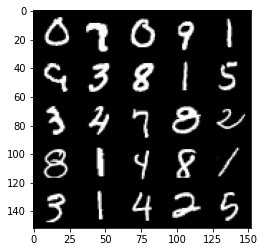

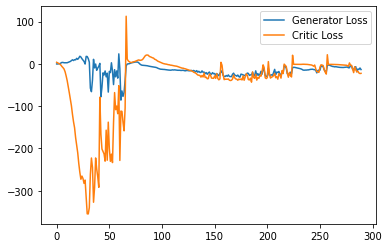

Step 5850: Generator loss: -12.656711228489876, critic loss: -22.330713472366334


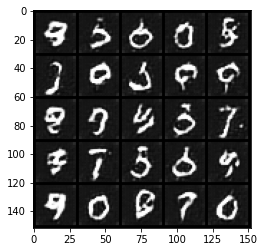

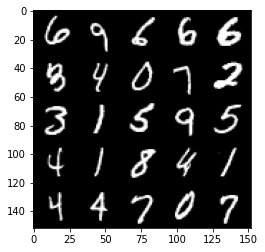

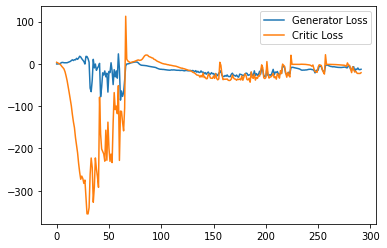

Step 5900: Generator loss: -5.196718928813934, critic loss: -12.937264646530155


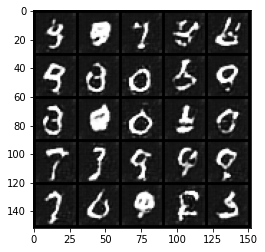

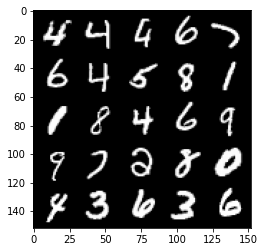

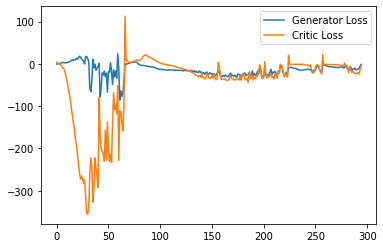

Step 5950: Generator loss: -11.69243893444538, critic loss: -19.554107339859005


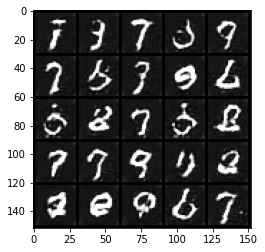

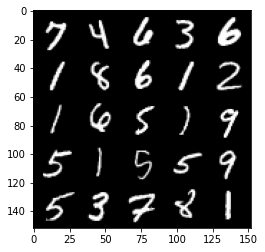

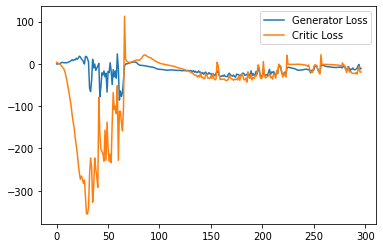

Step 6000: Generator loss: -4.909003446102142, critic loss: -14.2459374742508


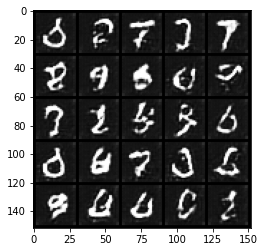

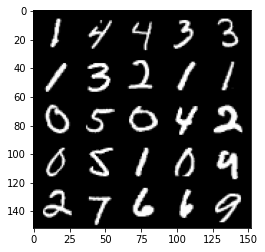

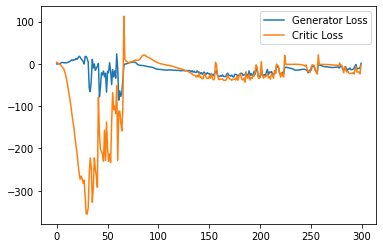

Step 6050: Generator loss: -8.984571532011032, critic loss: -18.811591024398805


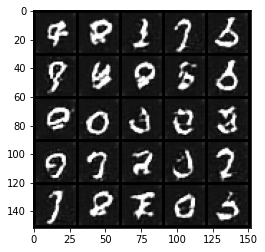

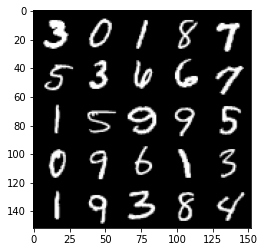

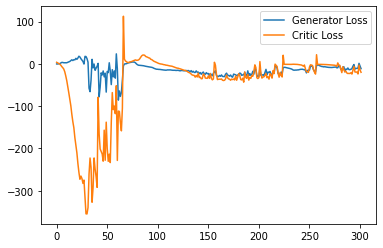

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6100: Generator loss: -0.15784429192543029, critic loss: 3.6318806996345523


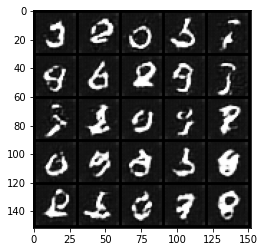

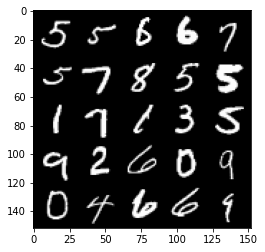

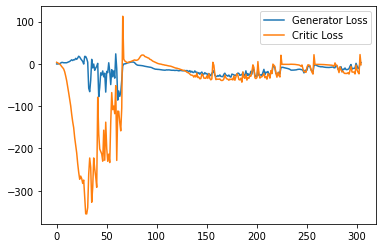

Step 6150: Generator loss: 1.1725025330483914, critic loss: -1.7401080269813531


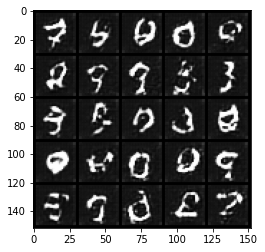

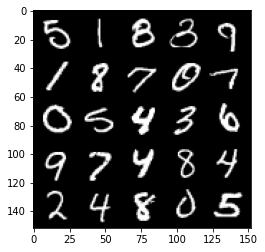

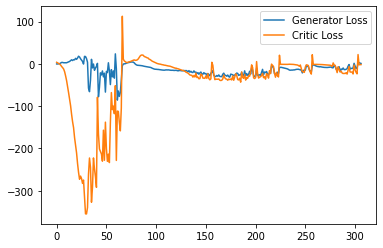

Step 6200: Generator loss: 0.11328387565910816, critic loss: -1.8434308433532718


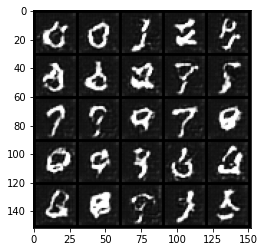

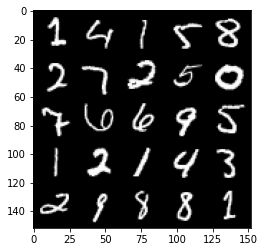

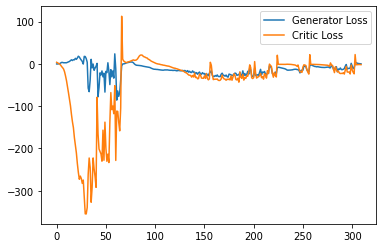

Step 6250: Generator loss: -0.7587521281093359, critic loss: -2.170207788944245


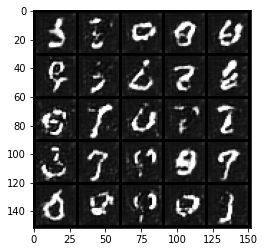

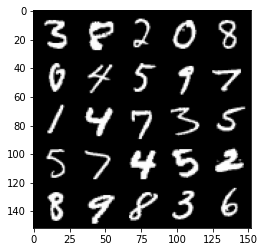

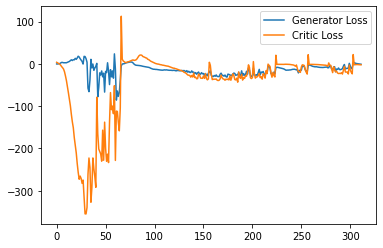

Step 6300: Generator loss: -1.951420657634735, critic loss: -2.3122734656333925


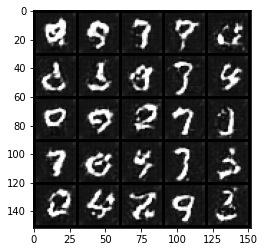

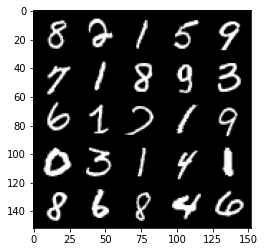

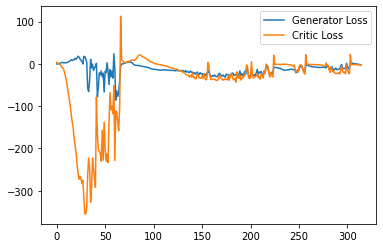

Step 6350: Generator loss: -1.607009185552597, critic loss: -3.7649327621459965


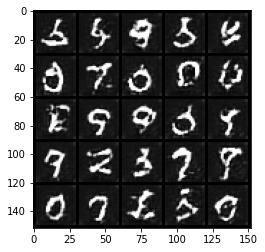

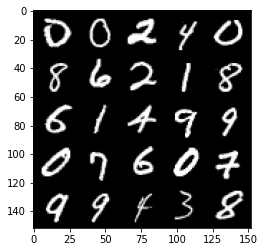

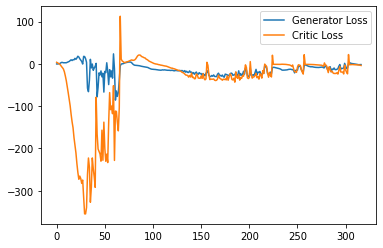

Step 6400: Generator loss: -5.532131315469742, critic loss: -11.572411163330077


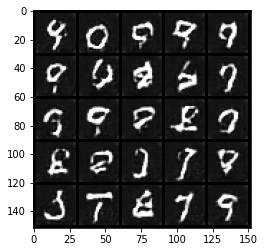

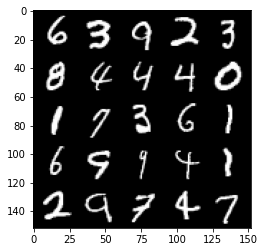

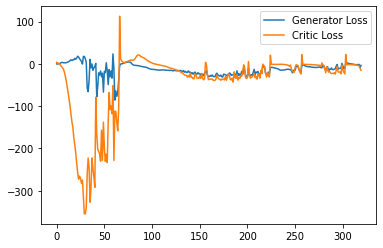

Step 6450: Generator loss: -11.015020045042037, critic loss: -21.067615281105045


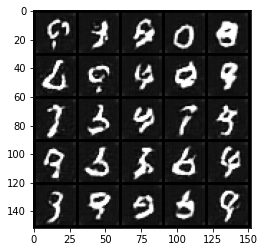

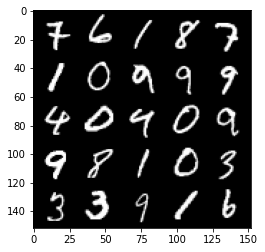

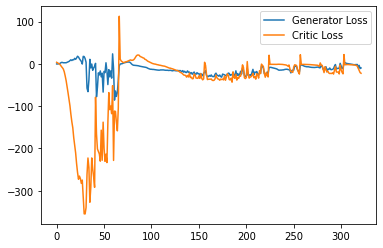

Step 6500: Generator loss: -4.70387148976326, critic loss: -6.1665718967914565


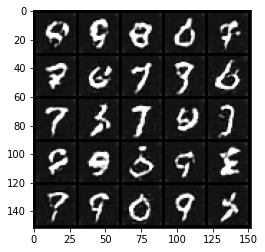

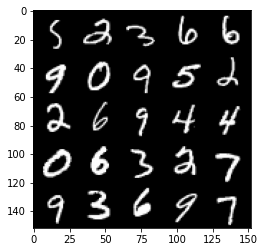

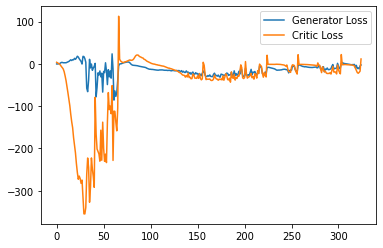

Step 6550: Generator loss: 5.289123640060425, critic loss: -1.8062075526714327


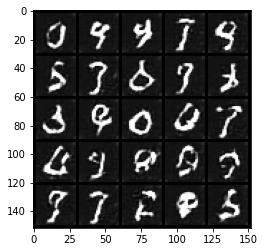

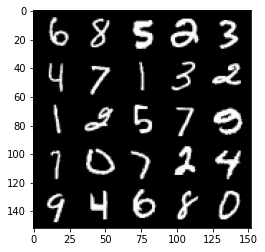

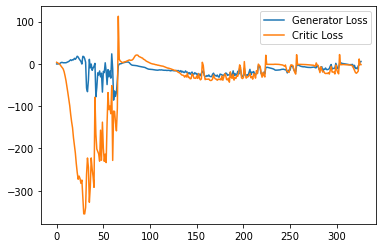

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6600: Generator loss: 3.8530614042282103, critic loss: -1.791273811101914


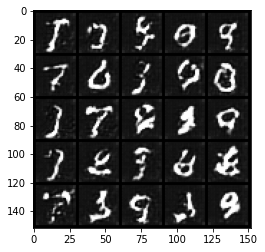

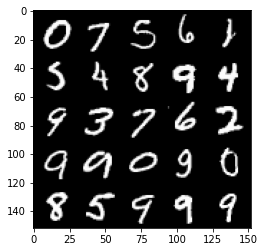

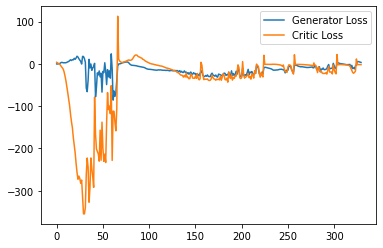

Step 6650: Generator loss: 1.9906108236312867, critic loss: -2.1207681350708003


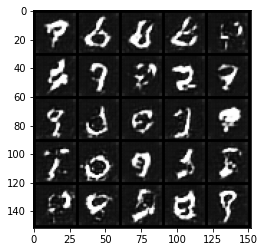

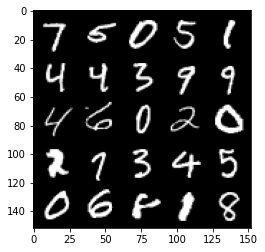

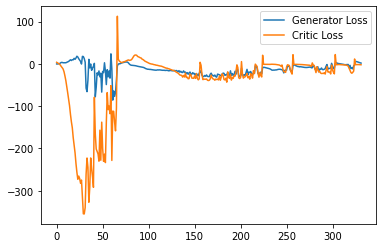

Step 6700: Generator loss: 1.2520742064714432, critic loss: -2.6274436516761783


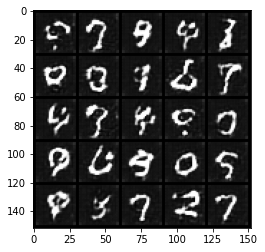

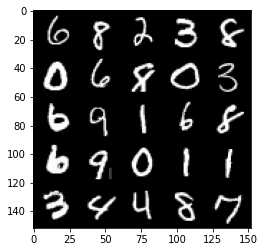

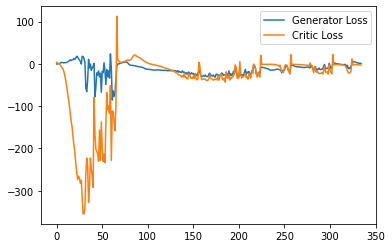

Step 6750: Generator loss: 0.7978054162114858, critic loss: -2.9463115310668946


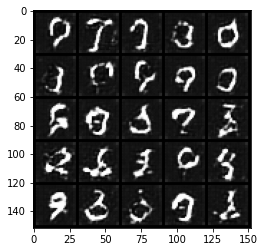

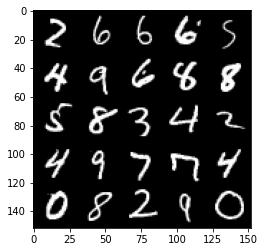

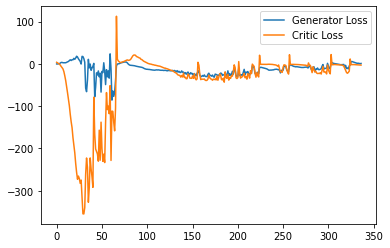

Step 6800: Generator loss: 0.4869983142055571, critic loss: -4.852953848838806


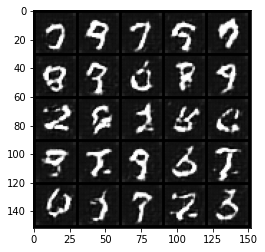

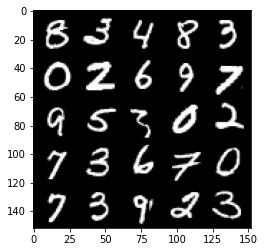

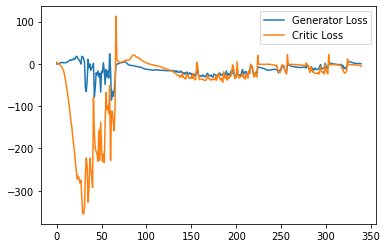

Step 6850: Generator loss: 0.9177128046751022, critic loss: 2.2483873705863933


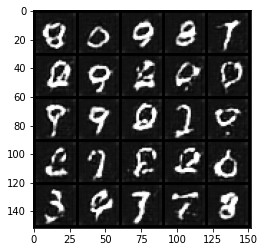

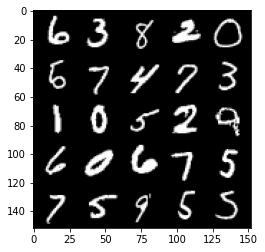

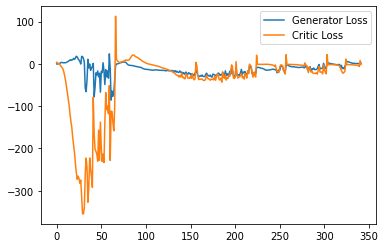

Step 6900: Generator loss: 2.4484419441223144, critic loss: -1.8841497912406924


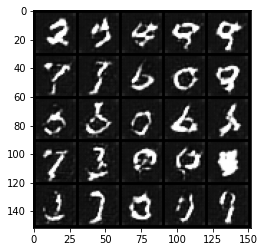

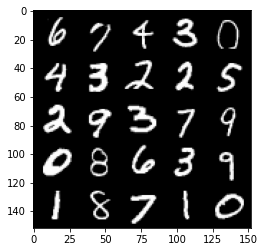

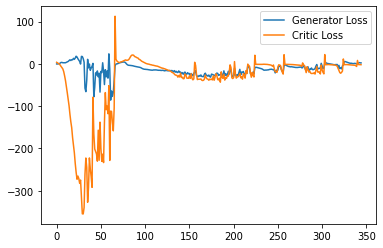

Step 6950: Generator loss: 1.912592625617981, critic loss: -2.477011465549469


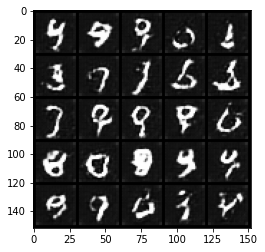

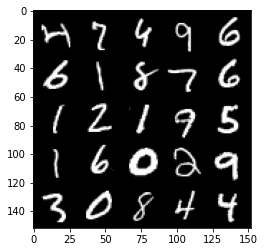

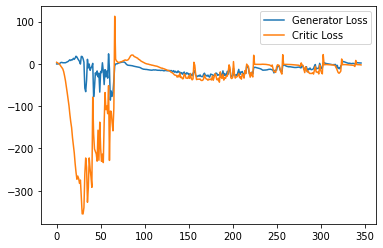

Step 7000: Generator loss: 1.3435941880196334, critic loss: -3.700151825904846


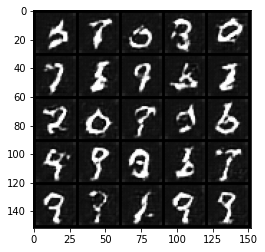

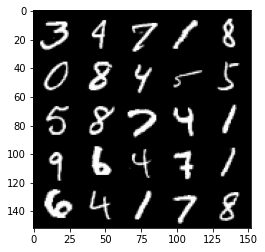

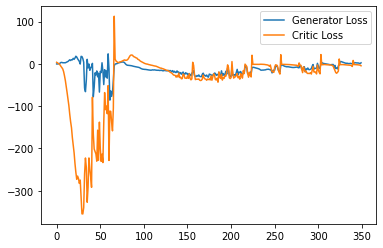

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7050: Generator loss: -3.546628212928772, critic loss: -11.999165024757385


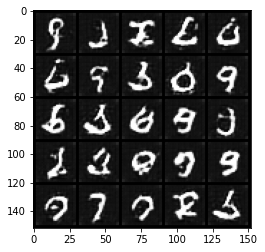

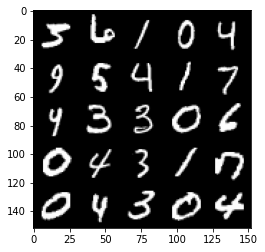

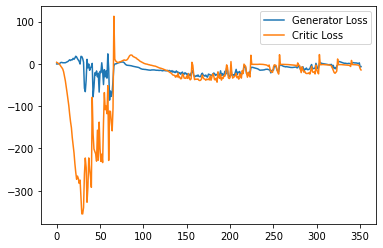

Step 7100: Generator loss: -3.0980895870923995, critic loss: -7.61123815059662


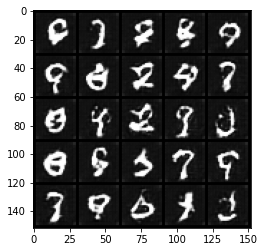

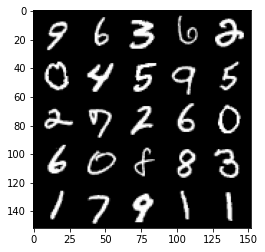

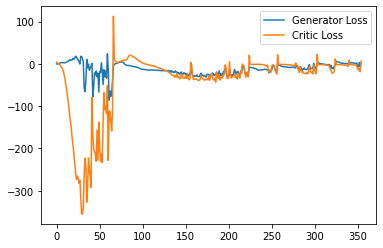

Step 7150: Generator loss: -4.453587956428528, critic loss: -13.33967596530914


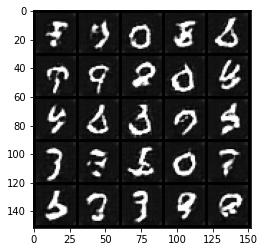

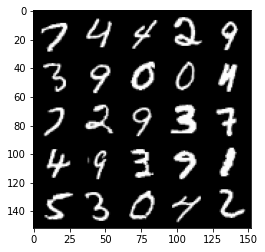

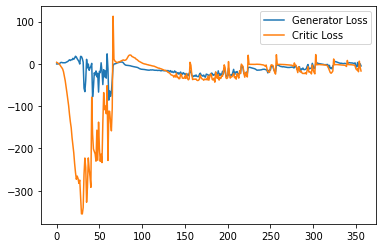

Step 7200: Generator loss: -3.8362714052200317, critic loss: -20.075396487236027


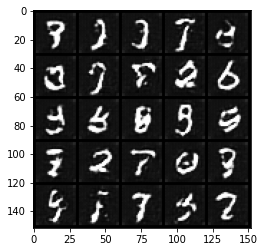

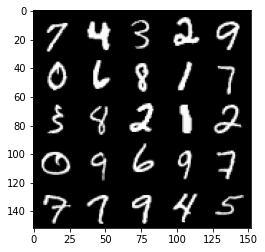

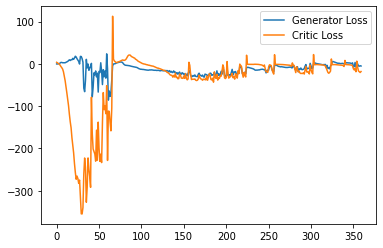

Step 7250: Generator loss: 0.5078266853094101, critic loss: -16.0256727771759


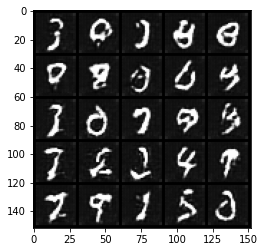

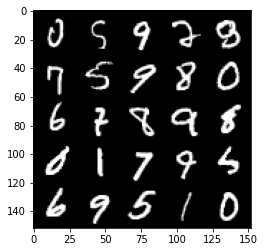

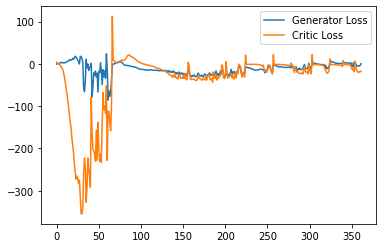

Step 7300: Generator loss: -0.26621235728263853, critic loss: -13.323016592979432


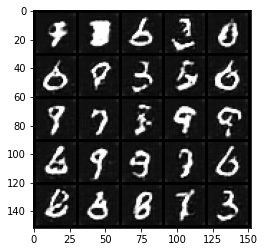

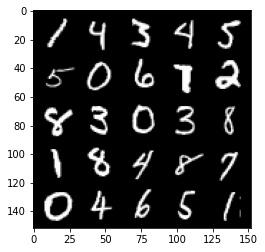

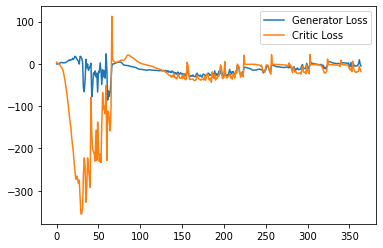

Step 7350: Generator loss: -1.0254710561037064, critic loss: -18.477698060989376


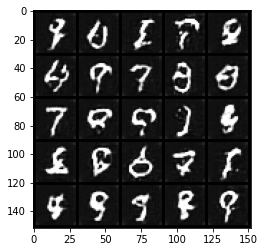

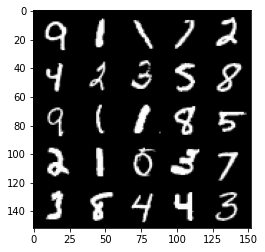

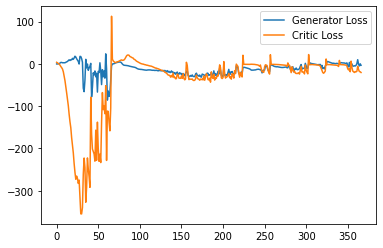

Step 7400: Generator loss: 3.2136672985553743, critic loss: -15.08824059963226


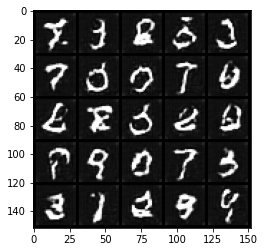

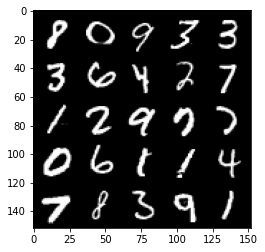

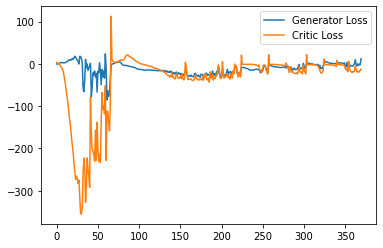

Step 7450: Generator loss: 3.8318895035982132, critic loss: -15.870118762016292


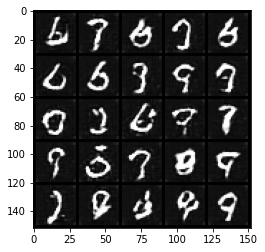

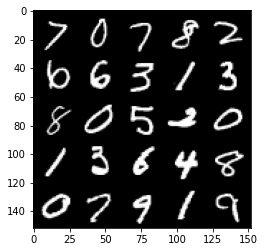

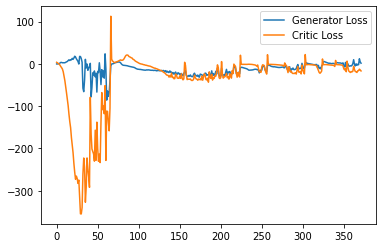

Step 7500: Generator loss: 12.810268688201905, critic loss: -1.9420469989776625


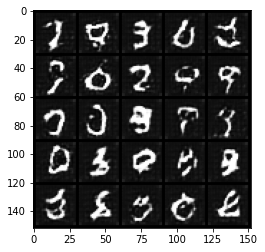

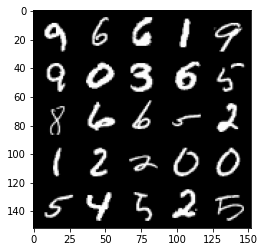

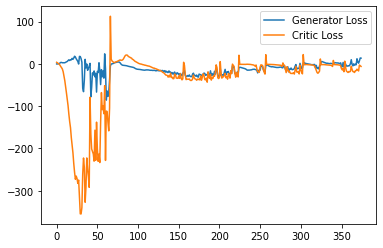

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7550: Generator loss: 6.311044092774392, critic loss: -10.613553667068482


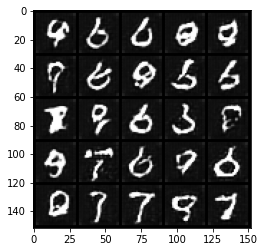

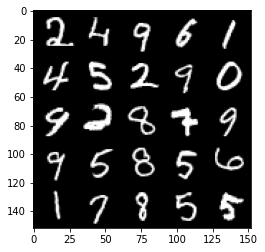

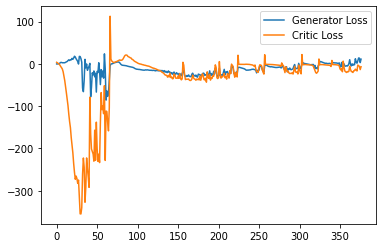

Step 7600: Generator loss: 3.1202000904083254, critic loss: -16.023905117988583


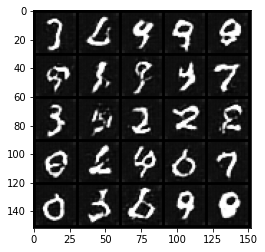

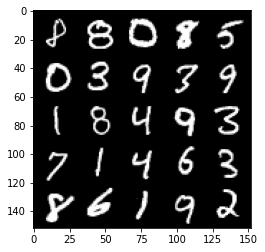

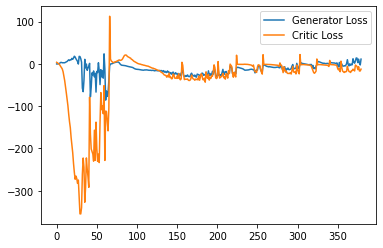

Step 7650: Generator loss: 6.569425801634789, critic loss: -15.493087686538694


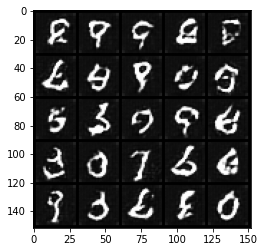

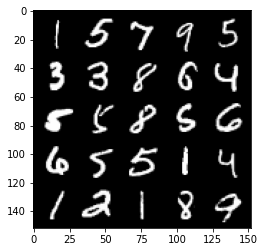

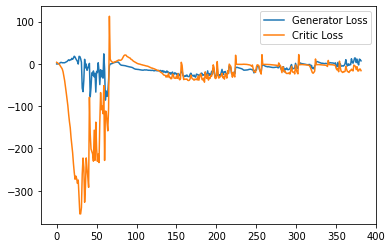

Step 7700: Generator loss: 10.22643874168396, critic loss: -3.427194713115693


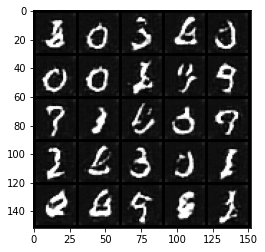

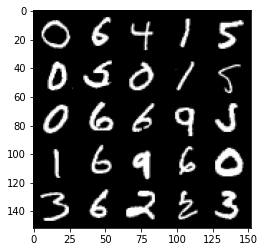

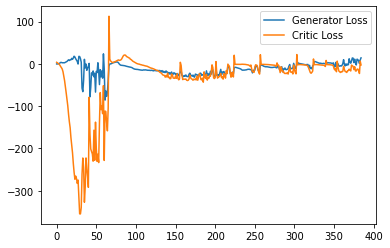

Step 7750: Generator loss: 13.544693622589111, critic loss: -2.75985201215744


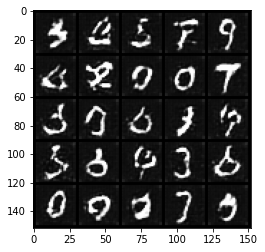

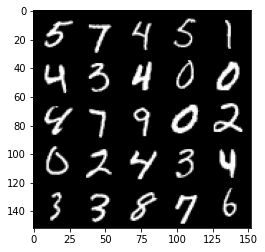

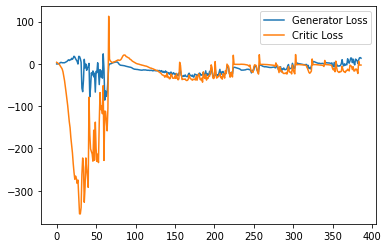

Step 7800: Generator loss: 11.382413778305054, critic loss: -4.4337788772583


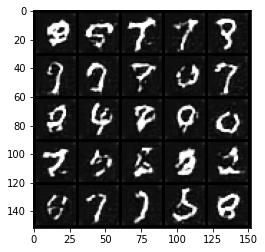

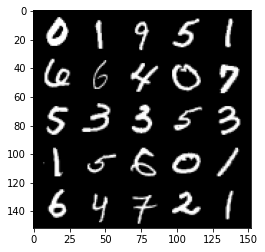

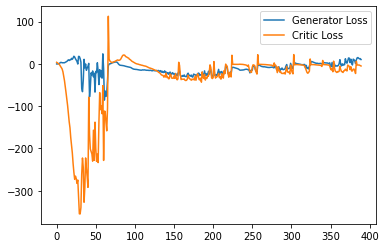

Step 7850: Generator loss: 3.6529703801870346, critic loss: -9.388213171958924


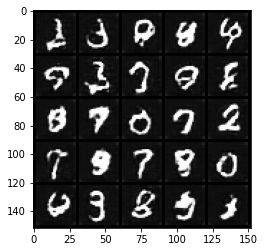

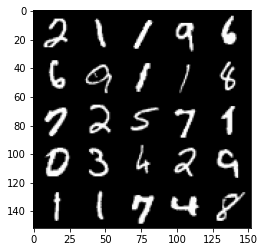

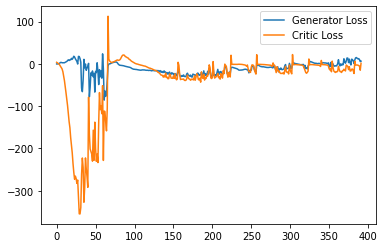

Step 7900: Generator loss: 7.777595496624708, critic loss: -13.47549127435684


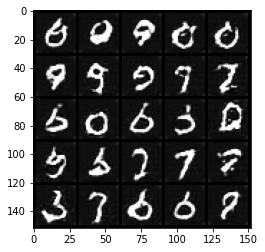

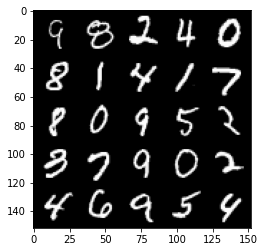

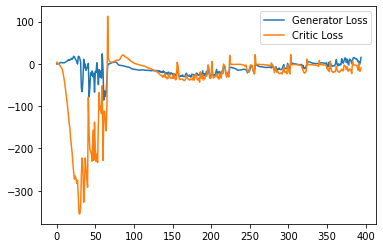

Step 7950: Generator loss: 4.600038801431656, critic loss: -15.559806034088142


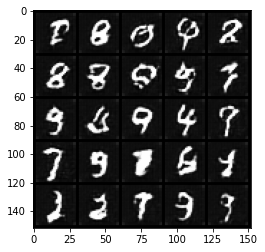

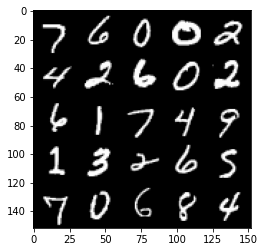

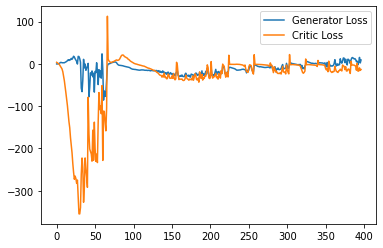

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8000: Generator loss: 6.59263291656971, critic loss: -14.825285278797148


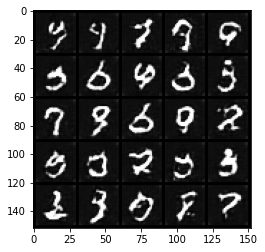

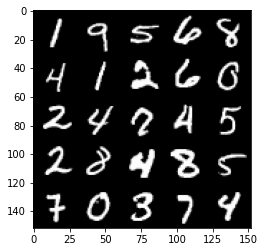

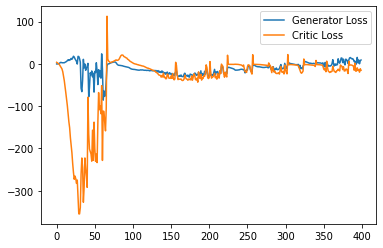

Step 8050: Generator loss: 9.393230635523796, critic loss: -13.978540771961214


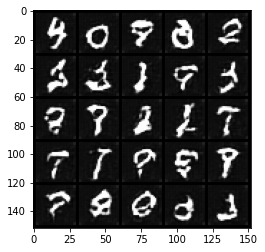

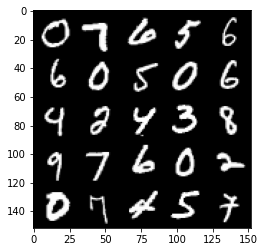

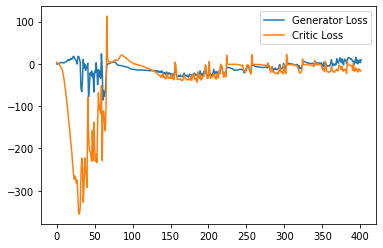

Step 8100: Generator loss: 7.845440700054168, critic loss: -15.105054554939272


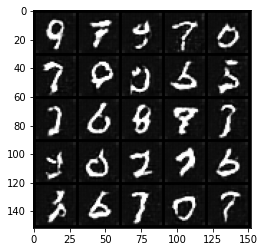

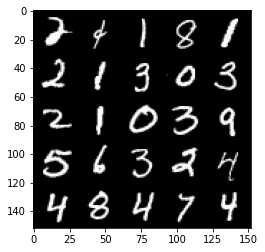

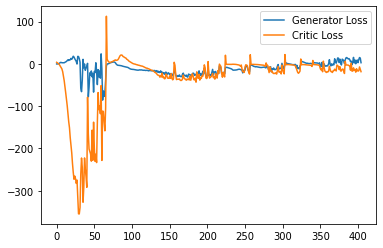

Step 8150: Generator loss: 8.798061561584472, critic loss: -5.2722935013771055


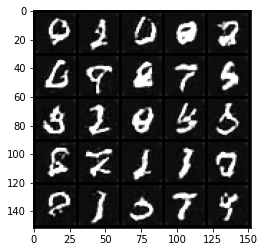

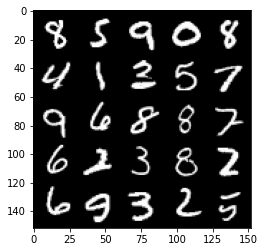

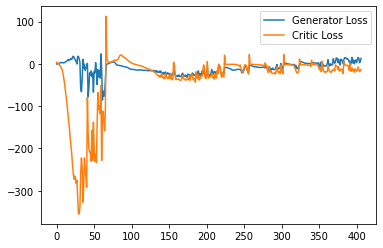

Step 8200: Generator loss: 15.836331901550293, critic loss: -2.114773087024689


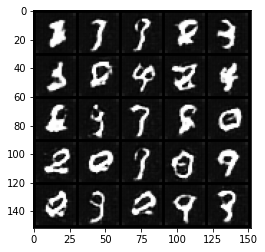

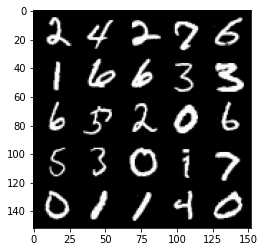

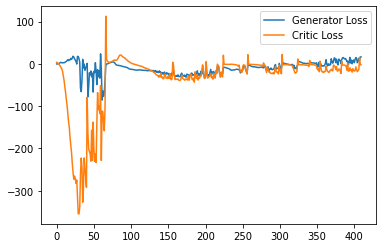

Step 8250: Generator loss: 14.095290317535401, critic loss: -3.129111474990846


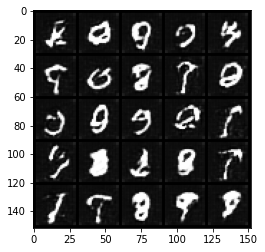

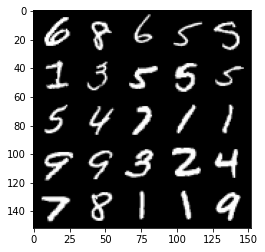

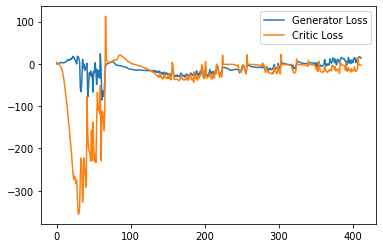

Step 8300: Generator loss: 3.4454408013820648, critic loss: -8.468553768157959


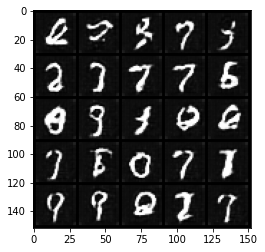

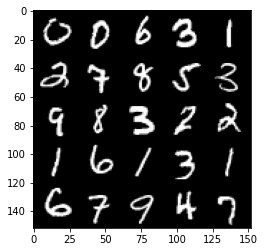

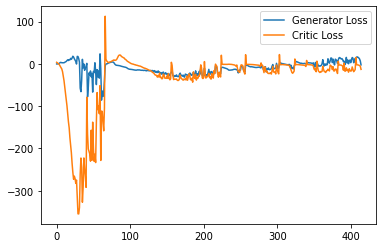

Step 8350: Generator loss: 7.376629528403282, critic loss: -12.941686531066898


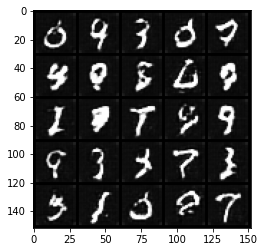

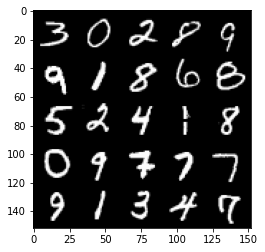

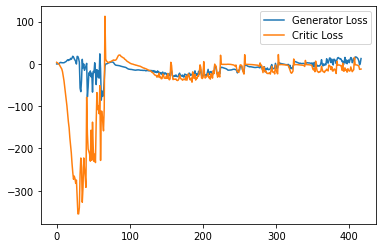

Step 8400: Generator loss: 10.265037633776664, critic loss: -14.403420150756837


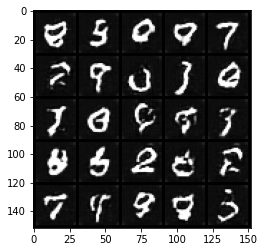

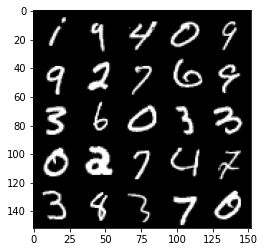

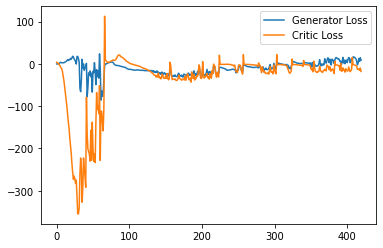

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8450: Generator loss: 12.36426650762558, critic loss: -10.786512880325315


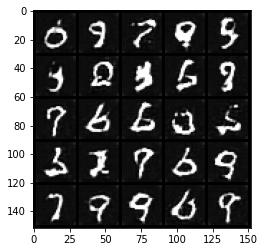

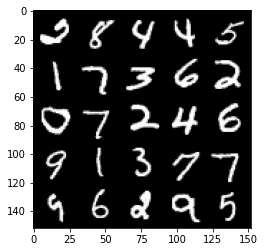

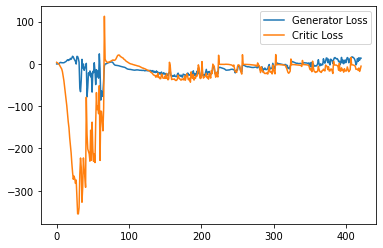

Step 8500: Generator loss: 16.07487409234047, critic loss: -13.451666806697848


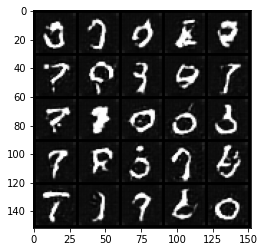

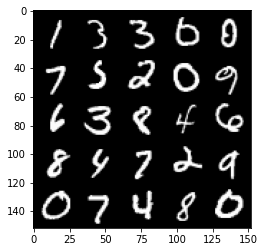

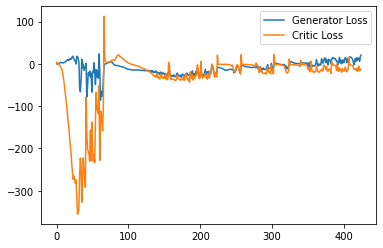

Step 8550: Generator loss: 13.407425963878632, critic loss: -16.59890058231354


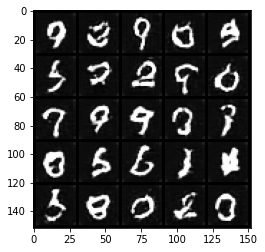

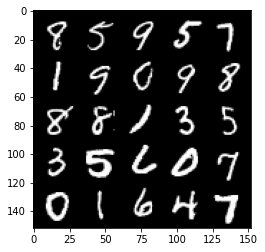

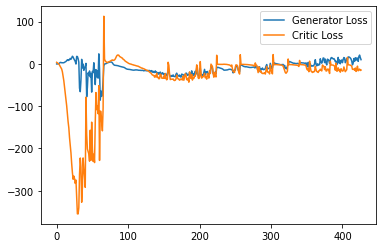

Step 8600: Generator loss: 11.601672271192074, critic loss: -16.90034992265701


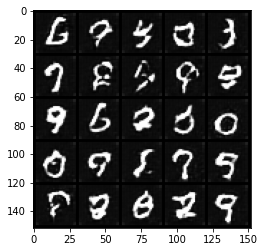

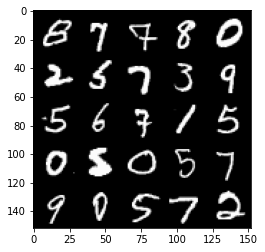

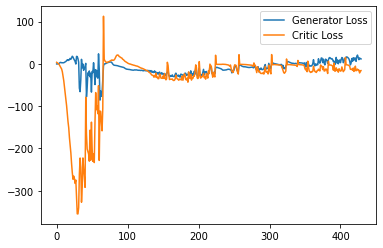

Step 8650: Generator loss: 17.68543920516968, critic loss: -14.236263529300693


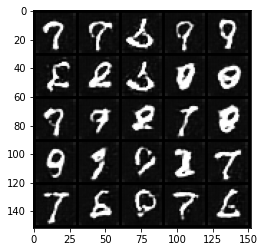

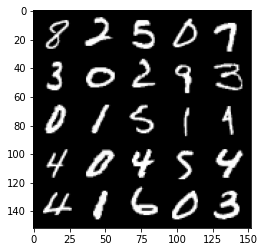

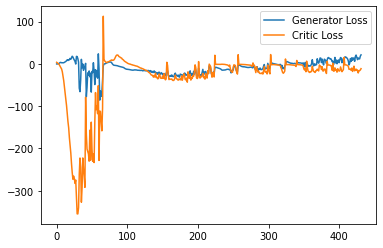

Step 8700: Generator loss: 14.35673477768898, critic loss: -4.251311574459076


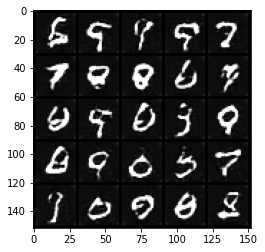

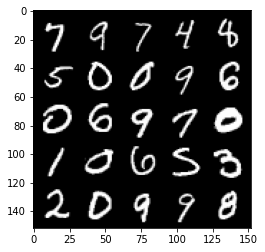

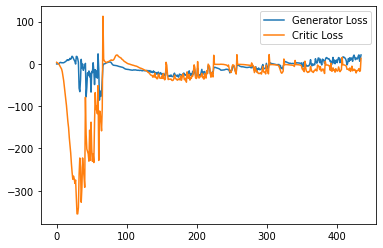

Step 8750: Generator loss: 14.922456724643707, critic loss: -7.503967118263245


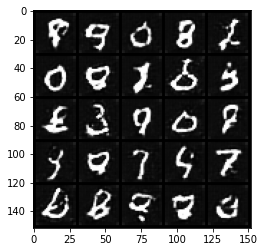

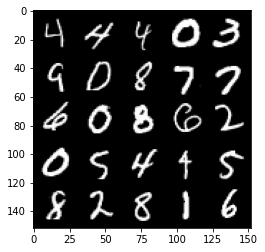

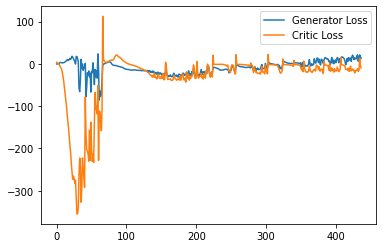

Step 8800: Generator loss: 17.530981521606446, critic loss: -7.014832695007323


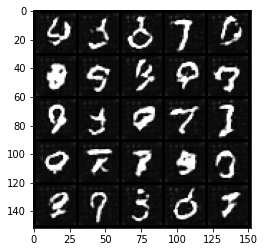

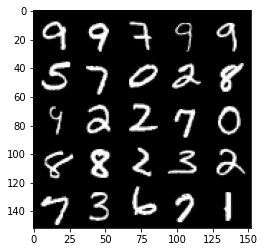

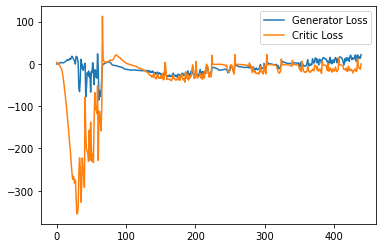

Step 8850: Generator loss: 15.241161571741104, critic loss: -12.339903787612911


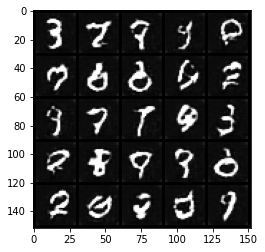

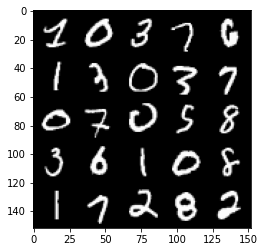

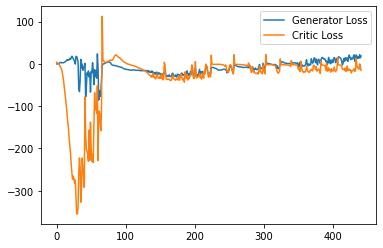

Step 8900: Generator loss: 13.503556548953057, critic loss: -17.792997508525847


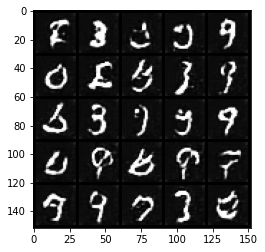

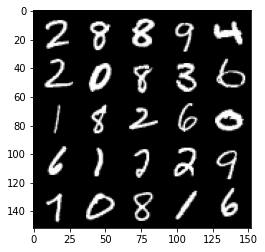

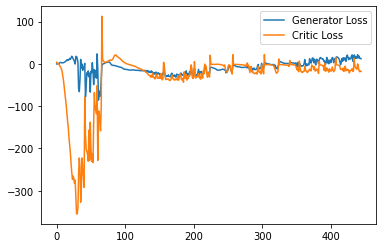

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8950: Generator loss: 20.86751572608948, critic loss: -5.351957979202271


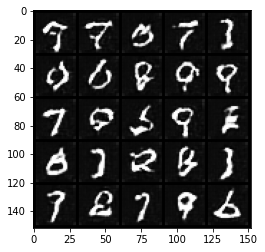

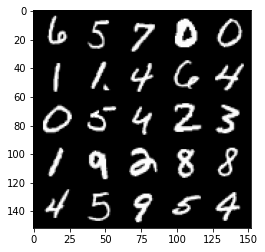

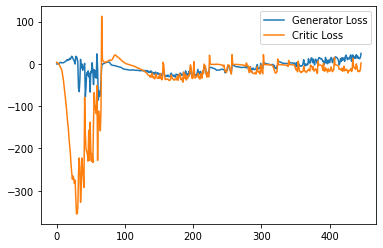

Step 9000: Generator loss: 15.703985857963563, critic loss: -14.02024449634552


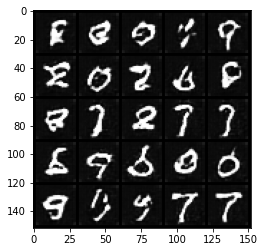

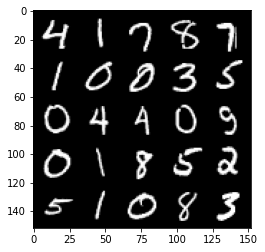

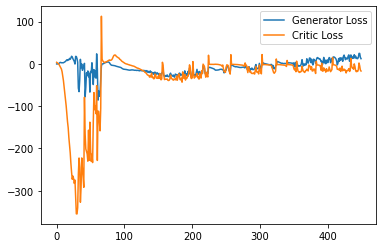

Step 9050: Generator loss: 18.116736023426057, critic loss: -13.732045678615568


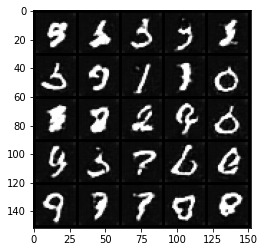

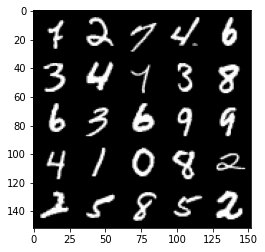

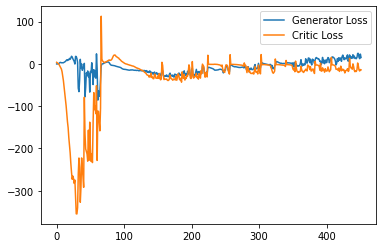

Step 9100: Generator loss: 22.355155634880067, critic loss: -8.404737254619597


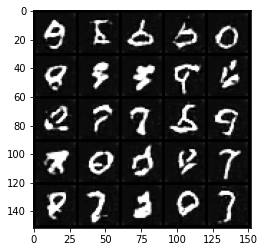

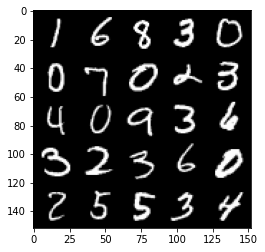

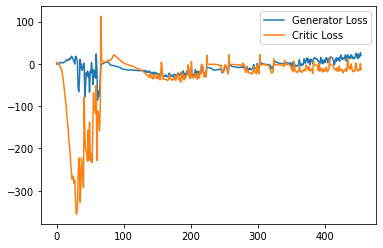

Step 9150: Generator loss: 25.143893203735352, critic loss: -13.094218708992004


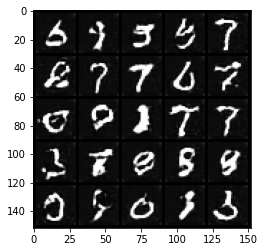

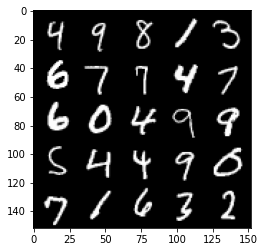

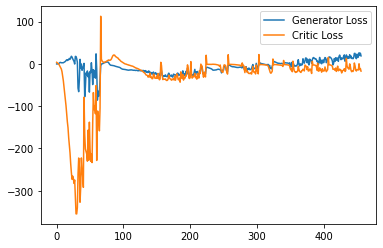

Step 9200: Generator loss: 22.907151107788085, critic loss: -15.798055751800543


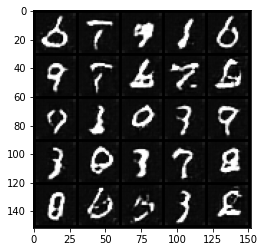

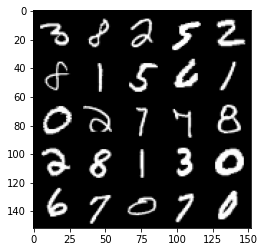

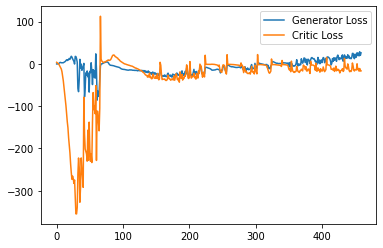

Step 9250: Generator loss: 17.154413418769835, critic loss: -15.397810683250425


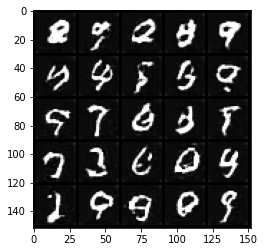

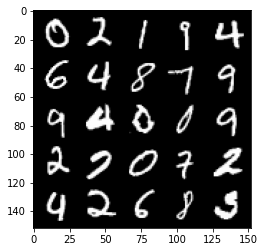

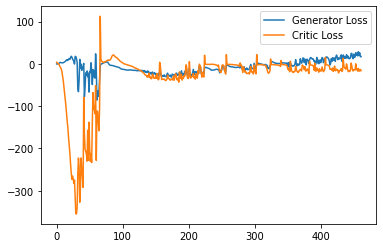

Step 9300: Generator loss: 21.05834624528885, critic loss: -13.244099309444428


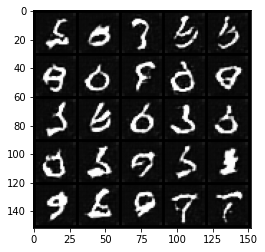

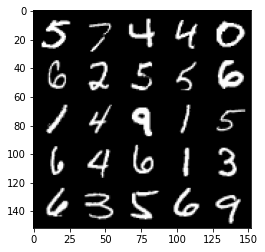

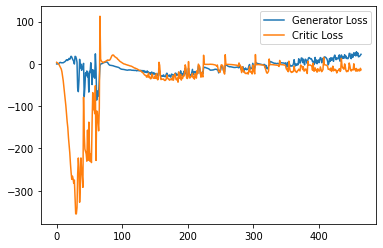

Step 9350: Generator loss: 25.669288921356202, critic loss: -11.508476286888122


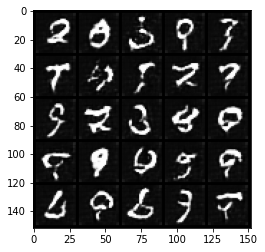

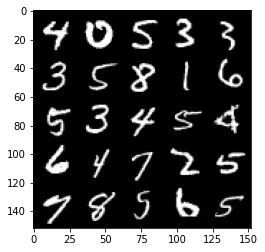

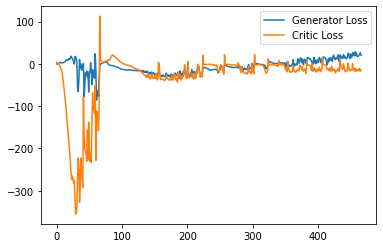

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9400: Generator loss: 19.640730533599854, critic loss: -15.353019748687746


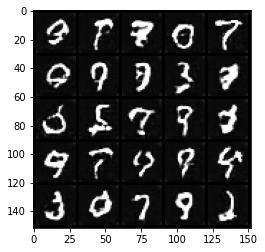

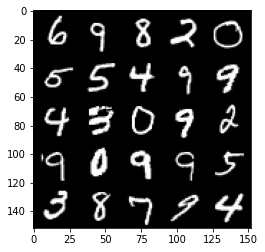

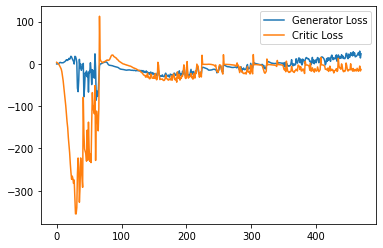

Step 9450: Generator loss: 20.141880645751954, critic loss: -14.680606442451474


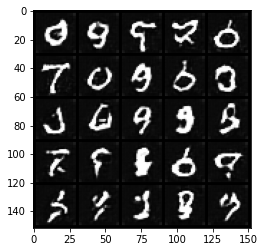

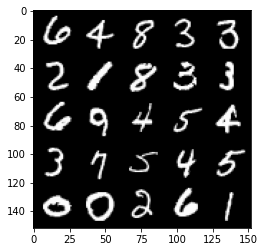

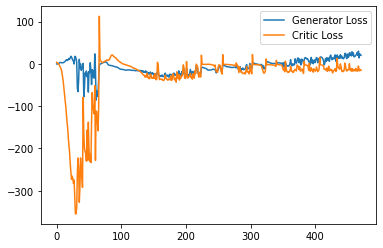

Step 9500: Generator loss: 27.768669090270997, critic loss: -12.731237668037414


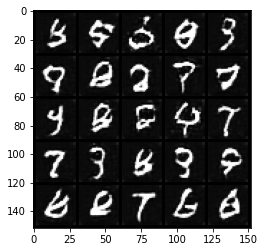

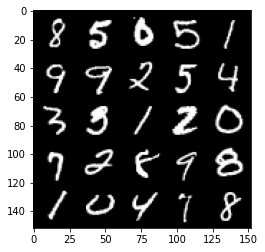

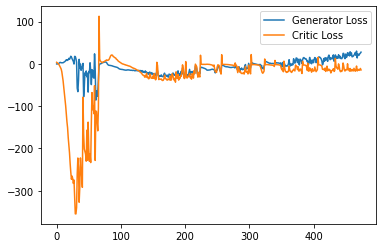

Step 9550: Generator loss: 25.100471000671387, critic loss: -14.702478336334222


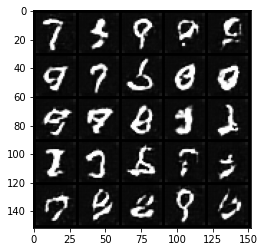

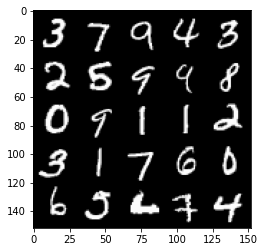

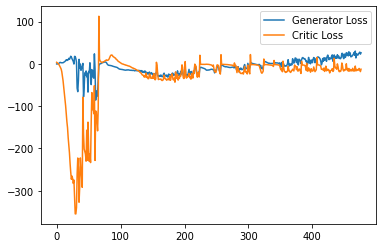

Step 9600: Generator loss: 21.91267072200775, critic loss: -19.11161925792694


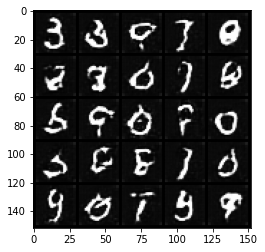

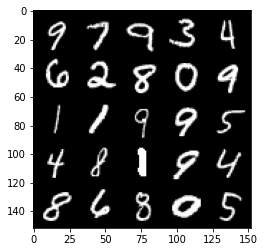

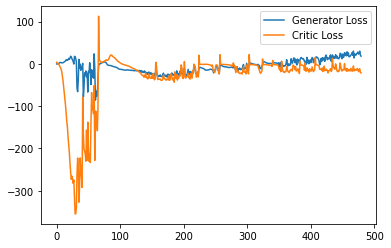

Step 9650: Generator loss: 28.498455991744994, critic loss: -1.196211376667025


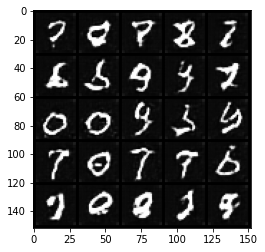

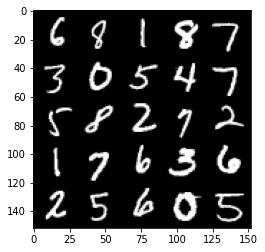

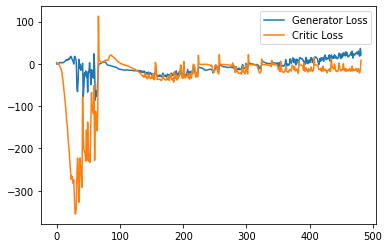

Step 9700: Generator loss: 28.86842891693115, critic loss: -2.098035894393921


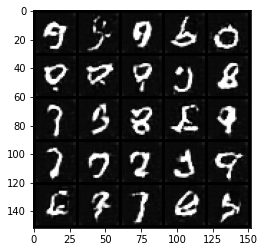

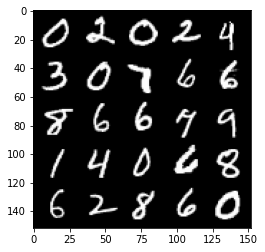

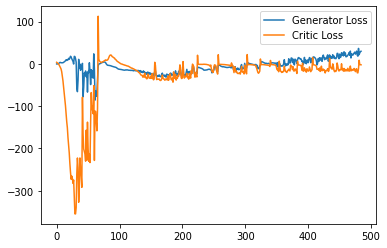

Step 9750: Generator loss: 29.624684715270995, critic loss: -2.2839740405082707


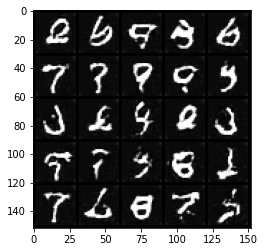

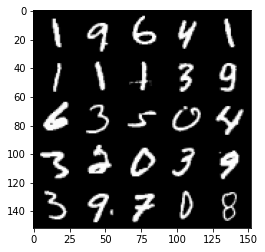

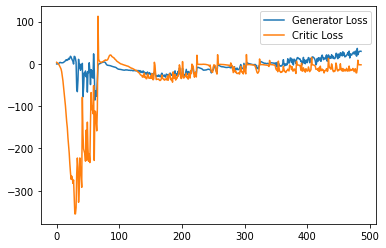

Step 9800: Generator loss: 28.731084480285645, critic loss: -2.4270171036720276


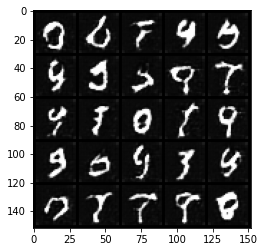

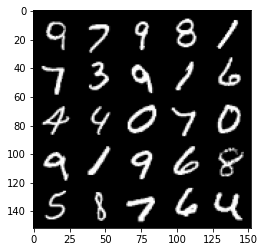

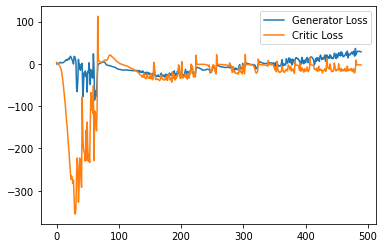

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9850: Generator loss: 27.929682960510252, critic loss: -2.61144408416748


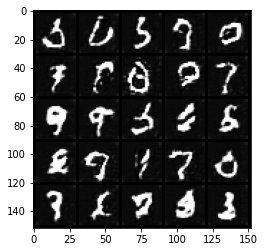

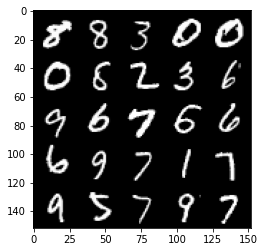

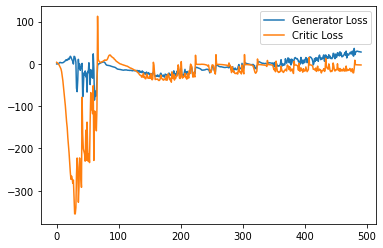

Step 9900: Generator loss: 26.729686584472656, critic loss: -2.9809594335556033


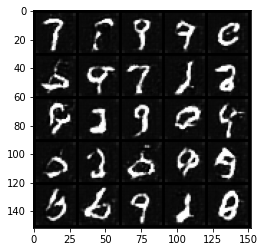

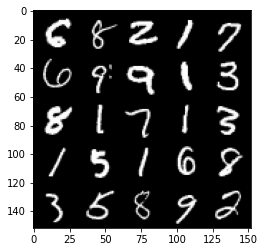

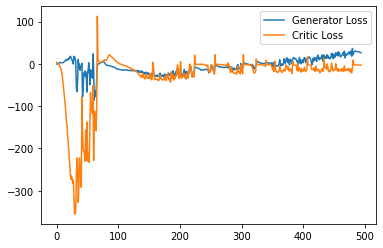

Step 9950: Generator loss: 23.227006282806396, critic loss: -5.833025655746459


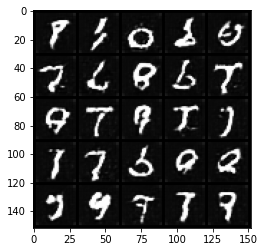

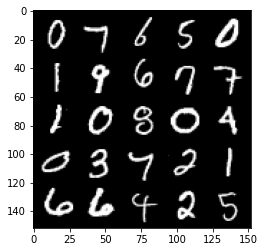

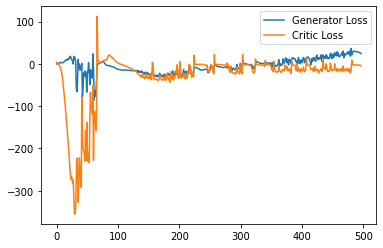

Step 10000: Generator loss: 17.564790935516356, critic loss: -8.90622575712204


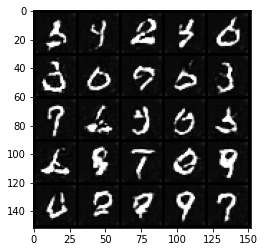

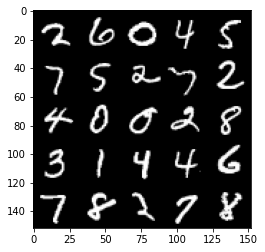

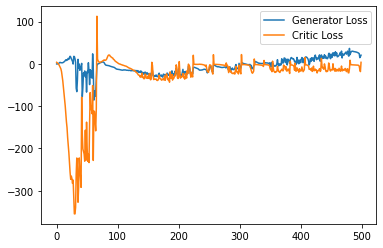

Step 10050: Generator loss: 31.870245895385743, critic loss: -3.879584688186644


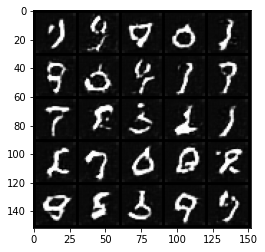

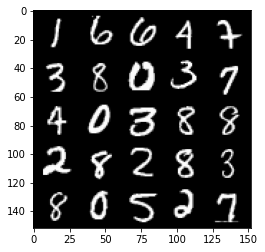

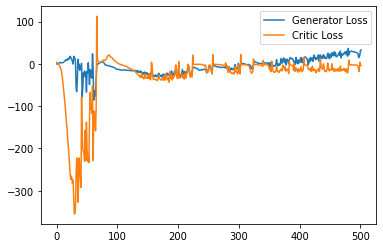

Step 10100: Generator loss: 24.79794442176819, critic loss: -10.101863146305083


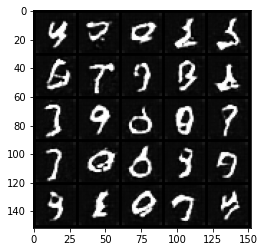

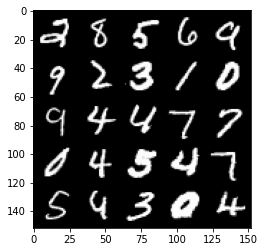

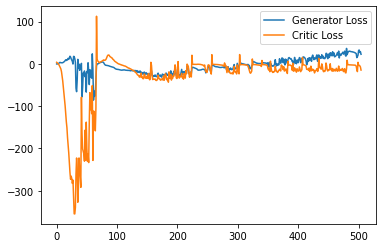

Step 10150: Generator loss: 27.23958441734314, critic loss: -12.379142243862152


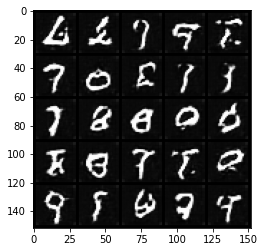

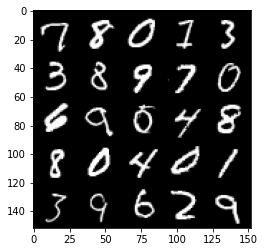

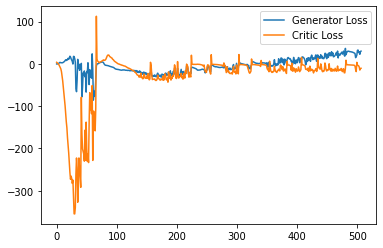

Step 10200: Generator loss: 24.5625715303421, critic loss: -14.74389983081817


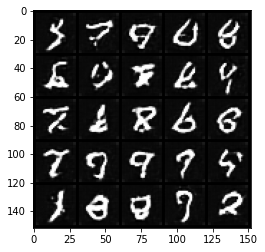

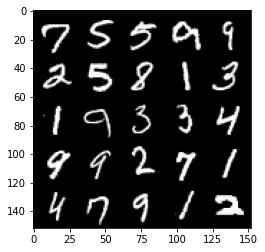

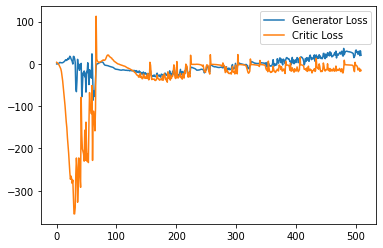

Step 10250: Generator loss: 29.716020793914794, critic loss: -4.425759289264679


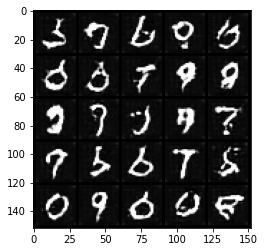

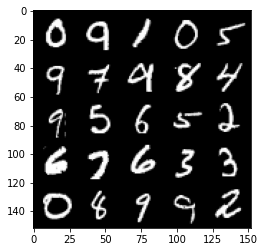

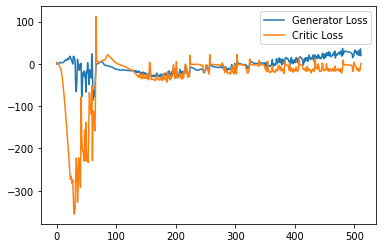

Step 10300: Generator loss: 23.031849431991578, critic loss: -13.524756407737732


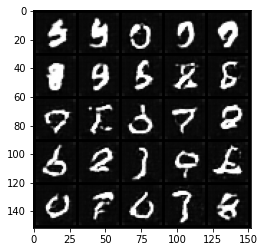

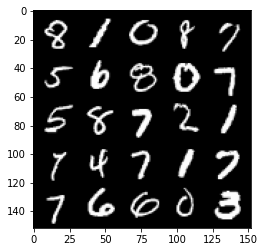

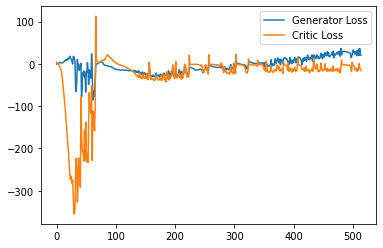

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10350: Generator loss: 28.77722288131714, critic loss: -12.743180562973025


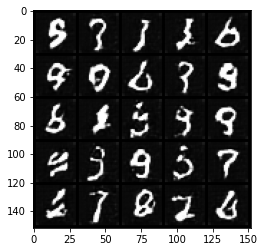

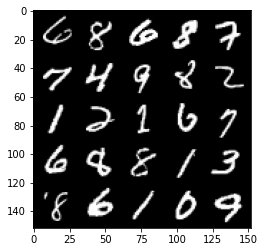

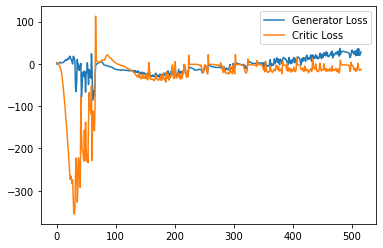

Step 10400: Generator loss: 29.9474365401268, critic loss: -7.280524787425994


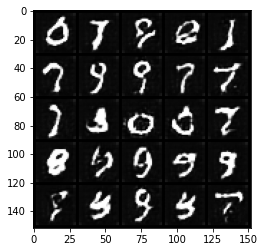

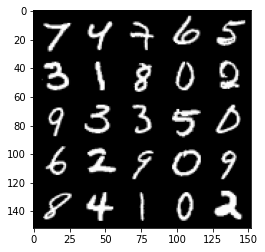

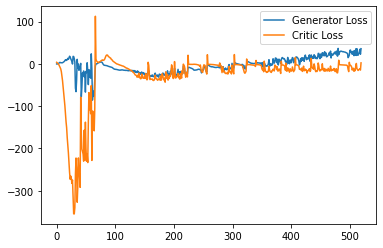

Step 10450: Generator loss: 25.021626806259157, critic loss: -12.730804749727248


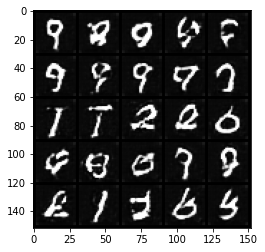

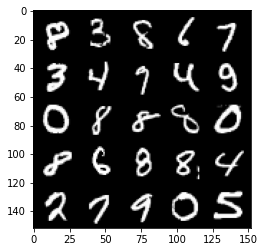

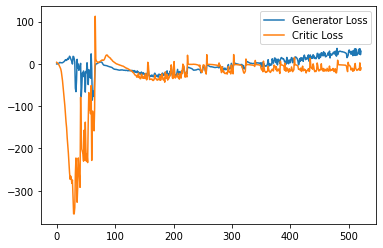

Step 10500: Generator loss: 27.720102882385255, critic loss: -14.650518269062038


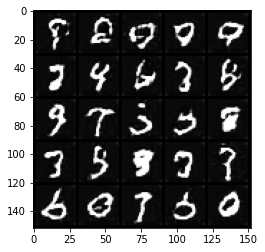

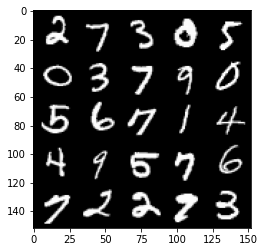

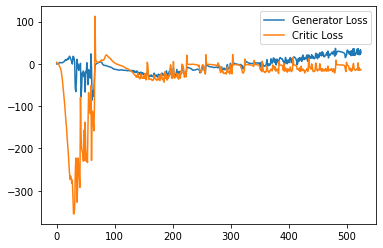

Step 10550: Generator loss: 30.79820872306824, critic loss: -13.07054102611542


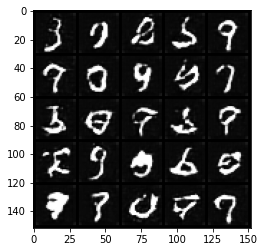

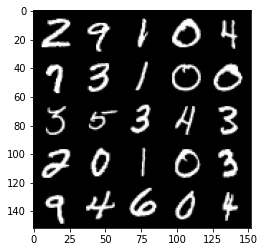

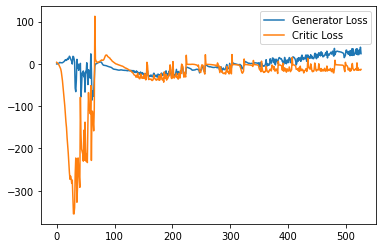

Step 10600: Generator loss: 29.452810440063477, critic loss: -15.967547045707704


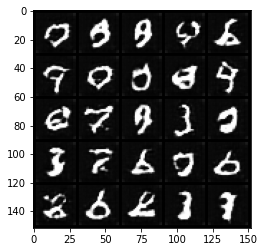

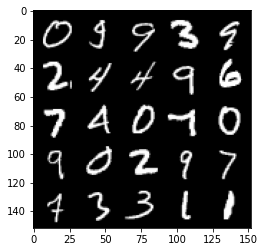

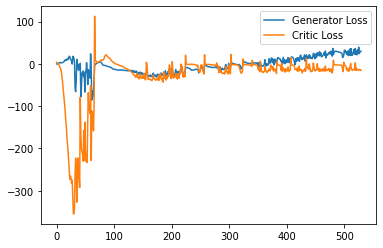

Step 10650: Generator loss: 30.592569007873536, critic loss: -13.25079597568512


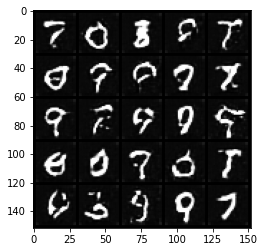

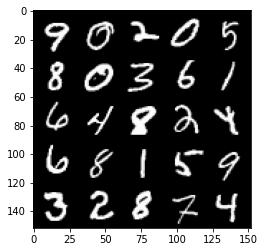

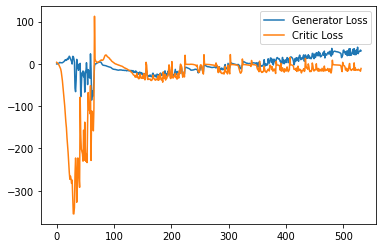

Step 10700: Generator loss: 26.71555651664734, critic loss: -7.890415239572524


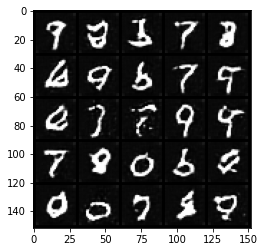

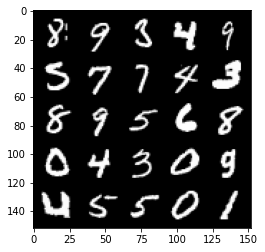

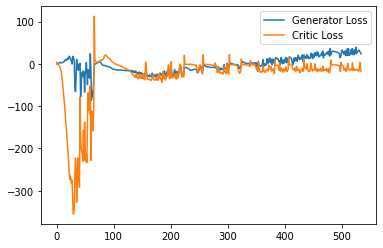

Step 10750: Generator loss: 34.43216217041016, critic loss: -14.361299592018124


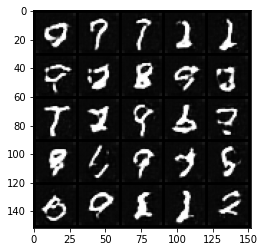

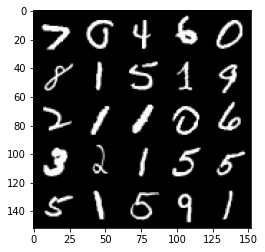

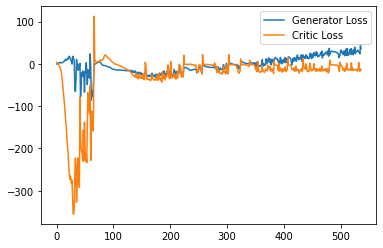

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10800: Generator loss: 33.70596137046814, critic loss: -11.020203178405762


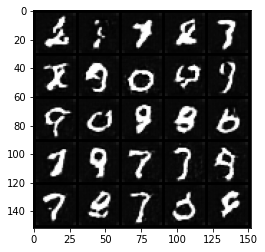

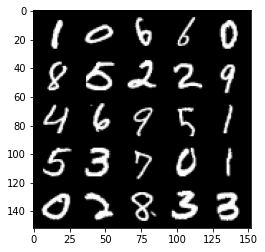

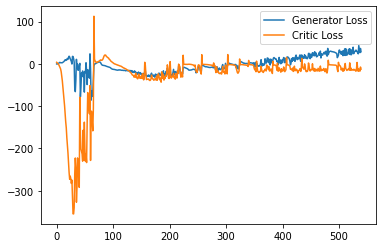

Step 10850: Generator loss: 32.36055927276611, critic loss: -12.529849398851395


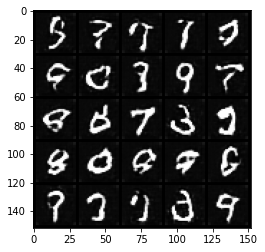

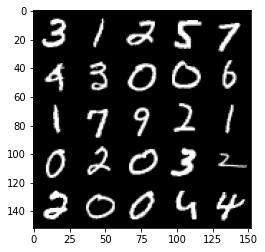

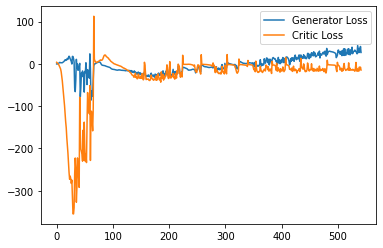

Step 10900: Generator loss: 30.74159261703491, critic loss: -16.118990878105162


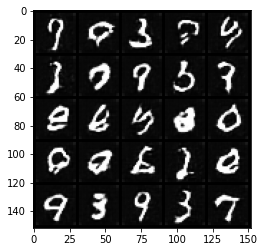

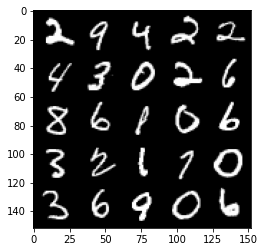

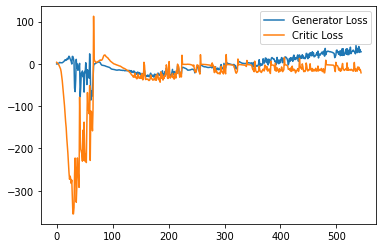

Step 10950: Generator loss: 36.2742240524292, critic loss: -11.542351770639423


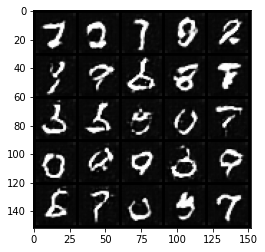

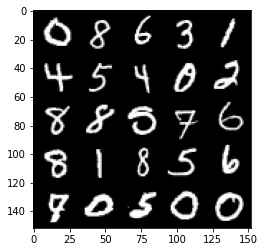

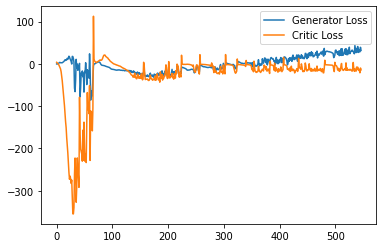

Step 11000: Generator loss: 33.56915987014771, critic loss: -12.20777588200569


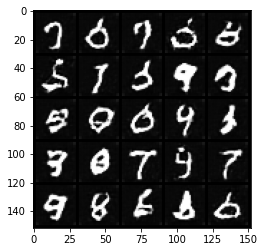

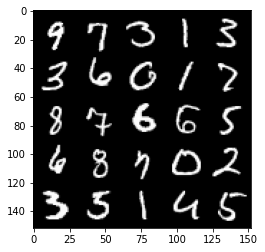

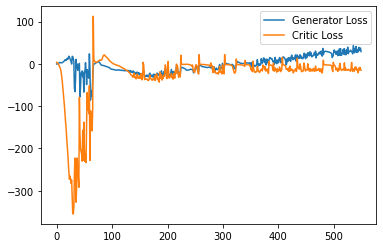

Step 11050: Generator loss: 25.703772802352905, critic loss: -19.813461338996888


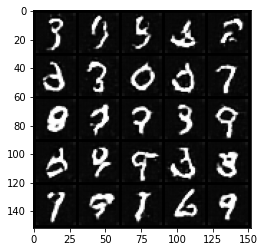

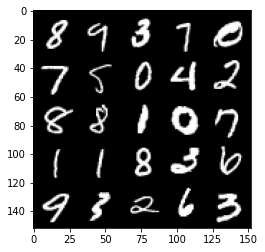

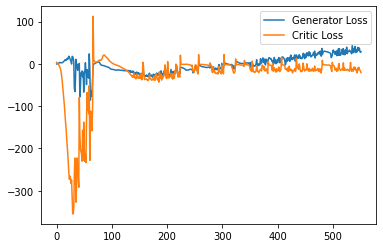

Step 11100: Generator loss: 29.69526954650879, critic loss: -17.103376081466667


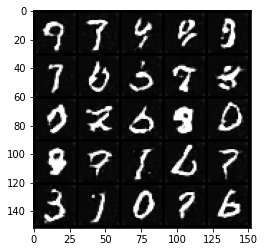

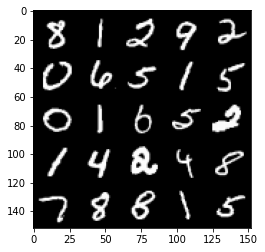

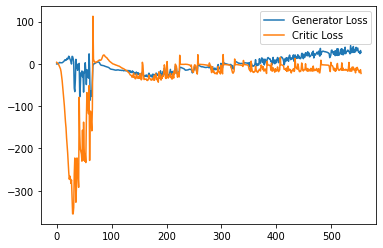

Step 11150: Generator loss: 40.244861106872555, critic loss: -13.063523417949675


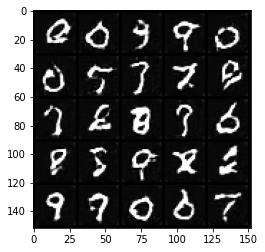

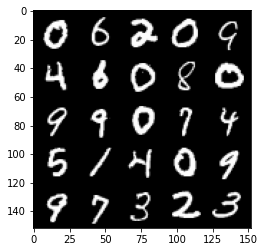

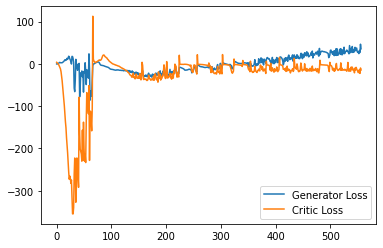

Step 11200: Generator loss: 29.974507484436035, critic loss: -17.610504130363466


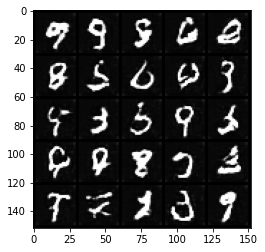

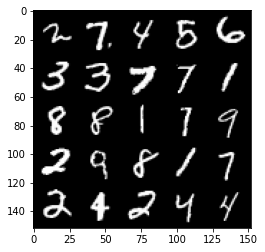

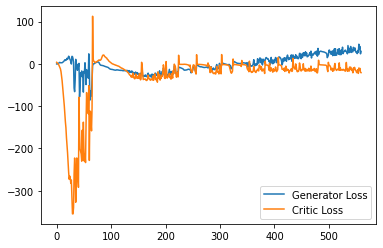

Step 11250: Generator loss: 41.603671913146975, critic loss: -12.460962876796719


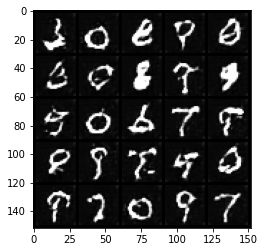

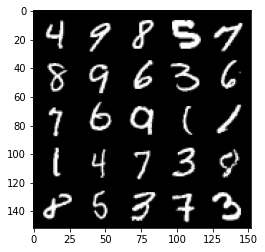

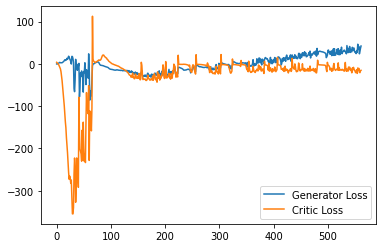

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11300: Generator loss: 40.43051036834717, critic loss: -12.475825720310214


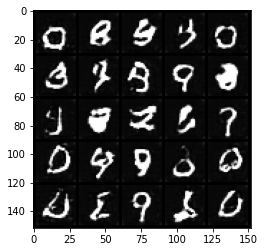

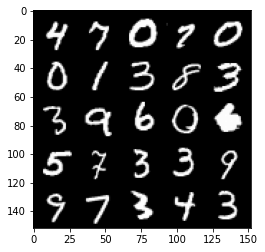

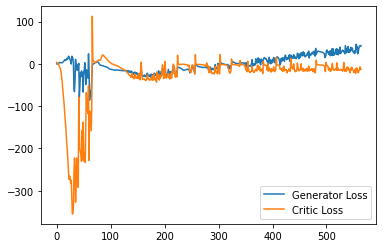

Step 11350: Generator loss: 30.154714126586914, critic loss: -18.234175734519955


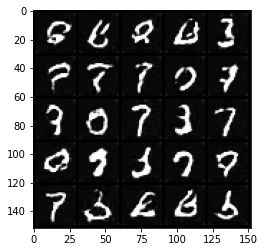

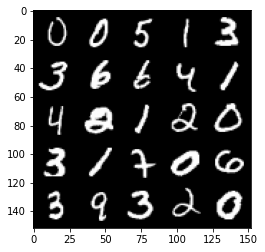

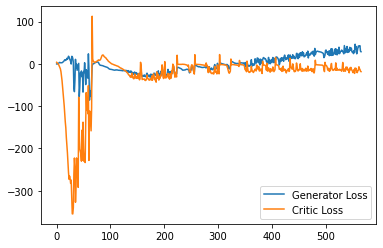

Step 11400: Generator loss: 43.34264038085937, critic loss: -15.457470575094222


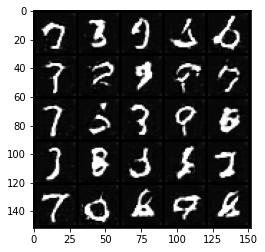

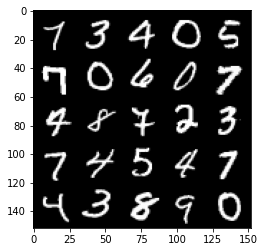

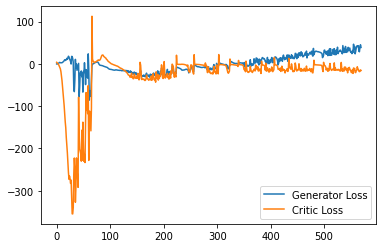

Step 11450: Generator loss: 35.54155191421509, critic loss: -14.149665057182313


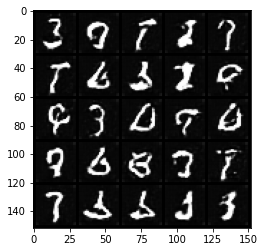

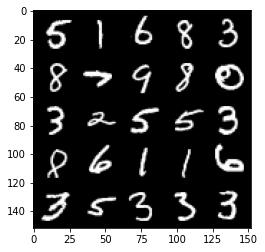

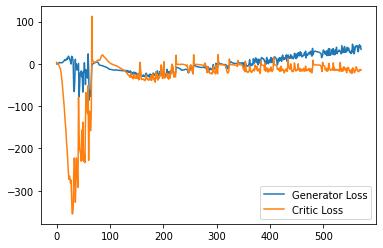

Step 11500: Generator loss: 35.60023391723633, critic loss: -9.79104861354828


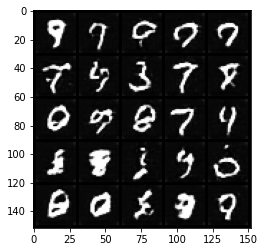

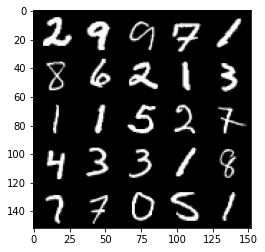

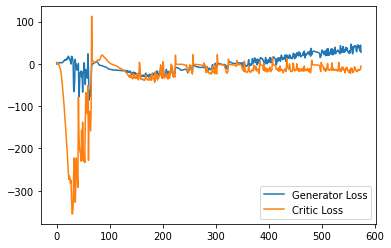

Step 11550: Generator loss: 35.85459957122803, critic loss: -13.941564300060275


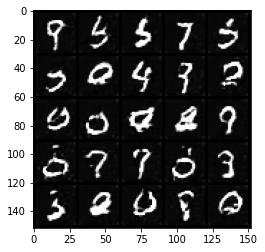

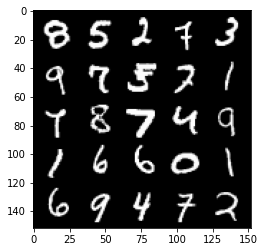

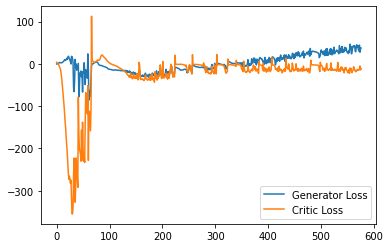

Step 11600: Generator loss: 38.6708402633667, critic loss: -14.912946486949922


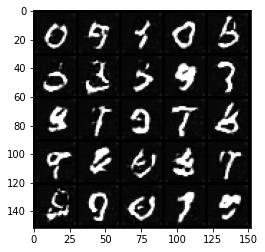

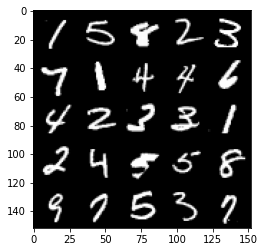

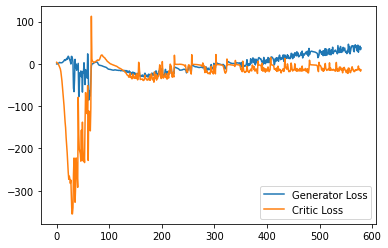

Step 11650: Generator loss: 32.528906707763674, critic loss: -14.891228282690047


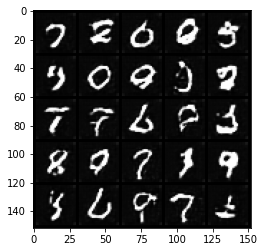

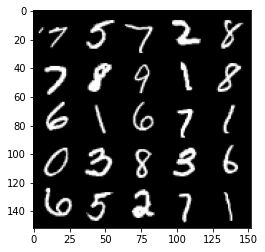

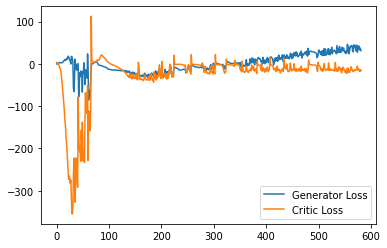

Step 11700: Generator loss: 37.256211547851564, critic loss: -16.560482851982115


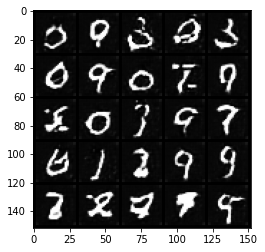

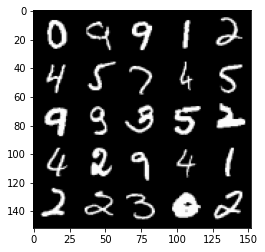

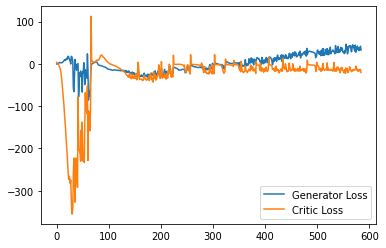

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11750: Generator loss: 37.21365810394287, critic loss: -18.1498719959259


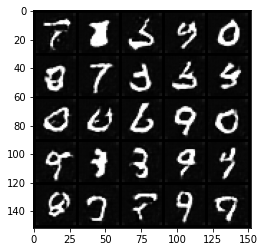

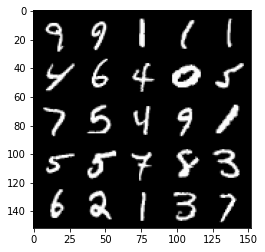

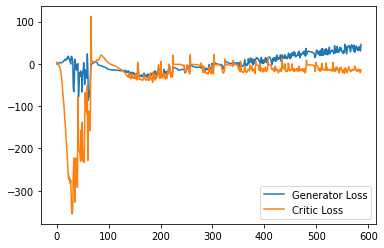

Step 11800: Generator loss: 37.1345426940918, critic loss: -17.484532137870787


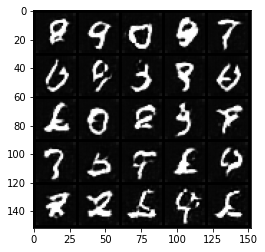

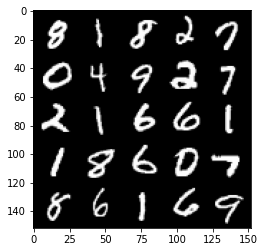

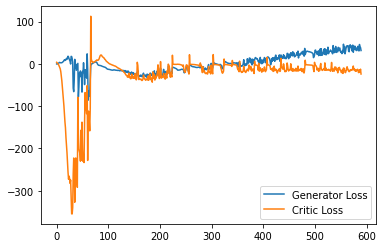

Step 11850: Generator loss: 43.34353385925293, critic loss: 2.359123708724977


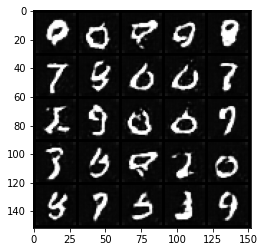

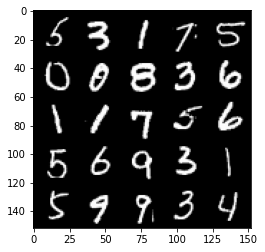

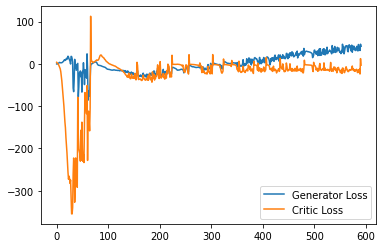

Step 11900: Generator loss: 34.467612495422365, critic loss: -10.438502603054049


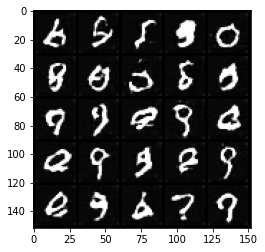

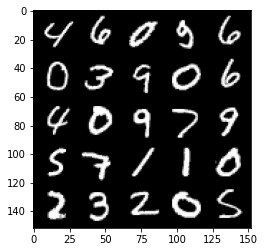

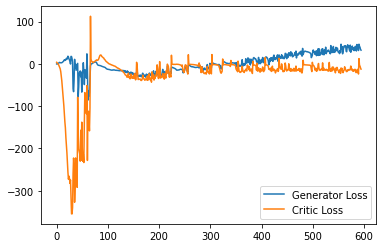

Step 11950: Generator loss: 37.15595321655273, critic loss: -14.597285196781161


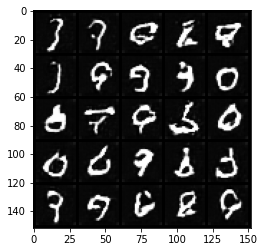

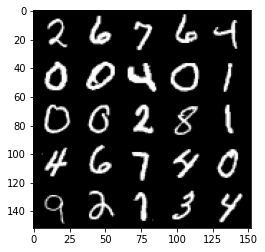

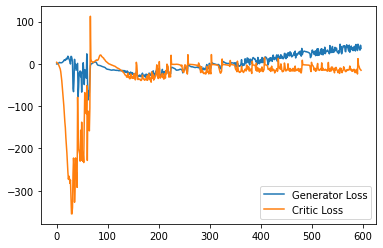

Step 12000: Generator loss: 44.60252071380615, critic loss: -14.622701596736908


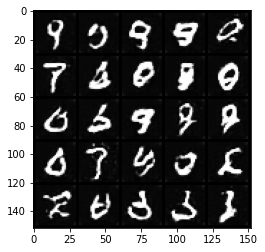

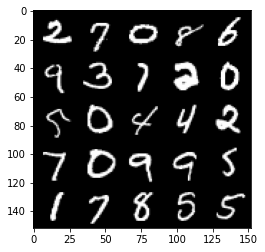

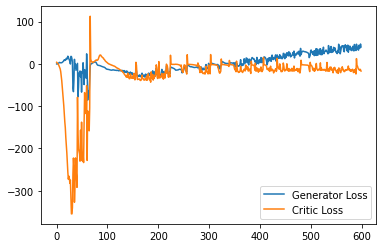

Step 12050: Generator loss: 37.72496326446533, critic loss: -18.925275231838224


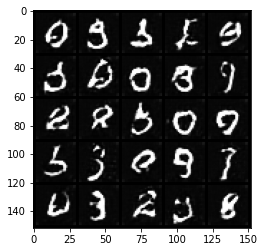

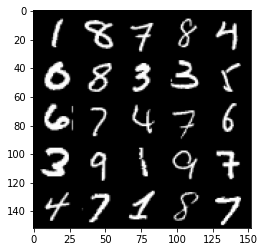

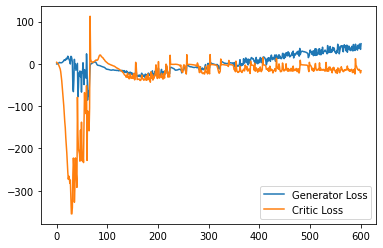

Step 12100: Generator loss: 37.158879356384276, critic loss: 1.8973344554901104


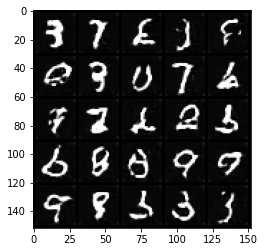

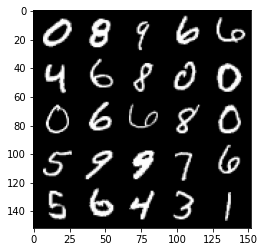

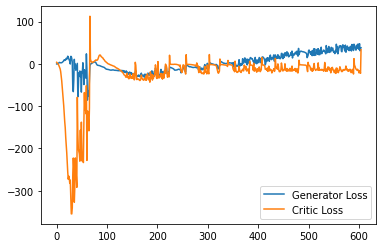

Step 12150: Generator loss: 41.94937156677246, critic loss: -2.645551137208938


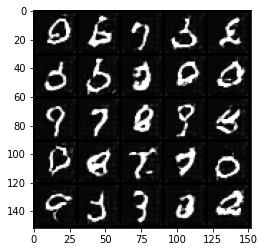

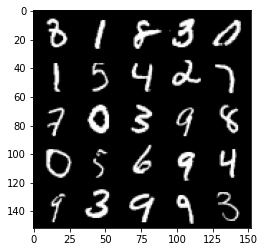

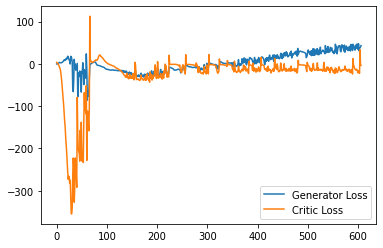

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12200: Generator loss: 46.465873870849606, critic loss: -4.964426404953003


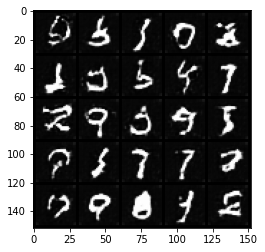

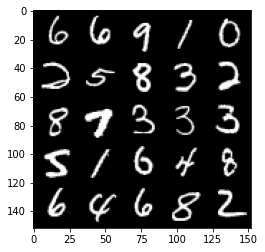

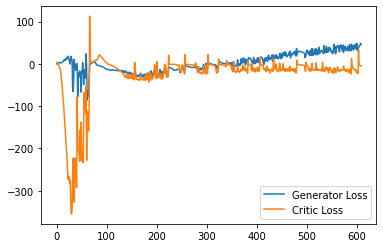

Step 12250: Generator loss: 36.16491722106934, critic loss: -15.047491193771364


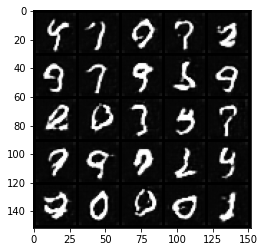

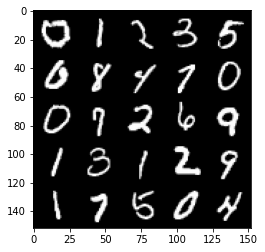

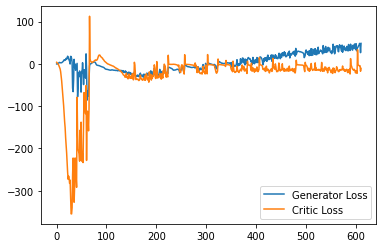

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
